# 02_Plot_Clustering_Performance

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import scanpy as sc
import pandas as pd
import numpy as np
import anndata as ad
import seaborn as sns   

# approximate original figure in http://spatial.libd.org/spatialLIBD/
palette_celltype={'L1':'#eb34a8',
                  'L2':'#3486eb',
                  'L3':'#34eb5b',
                  'L4':"#ae34eb",
                  'L5':'#ebdb34',
                  'L6':'#eb9234',
                  'WM':'#000000'}

palette_entity_anno = palette_celltype.copy()
palette_entity_anno['gene'] = "lightgray"

import simba as si

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_simba_only/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
tab10_palette = sns.color_palette("tab10", n_colors=10)
leiden_palette = {str(i): tab10_palette[i] for i in range(10)}

In [4]:
si.settings.set_figure_params(
    dpi=80,
    style='white',
    fig_size=[5,5],
    rc={'image.cmap': 'viridis'}
)

from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats('retina')
import matplotlib.pyplot as plt

In [5]:
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score

In [6]:
from benchmarking.plot import generate_umap_figures, generate_pca_figures, combine_images

# PCA

In [48]:
from benchmarking.cluster import run_leiden_clustering

In [9]:
pca_fn = "../results/00/pca_rna/run_pca.output.tsv"
pca_output_df = pd.read_csv(pca_fn, sep='\t', index_col=0)
pca_output_df.head()

,run_pca
151675,../results/00/pca_rna/151675
151507,../results/00/pca_rna/151507
151510,../results/00/pca_rna/151510
151674,../results/00/pca_rna/151674
151669,../results/00/pca_rna/151669


In [170]:
pca_performance_fn = "../results/00/pca_rna/run_pca.output.performance.tsv"
pca_performance_fn

'../results/00/pca_rna/run_pca.output.performance.tsv'

In [83]:
run_leiden_clustering(
    adata_output_df=pca_output_df,
    performance_output_fn=performance_output_fn,
    version='PCA'
)

100%|██████████| 12/12 [01:15<00:00,  6.30s/it]


In [171]:
pca_performance_df = pd.read_csv(pca_performance_fn, sep='\t', index_col=0)
pca_performance_df

,silhoutte,ARI,NMI,pca_adata_fn
151675,-0.013681,0.326027,0.420577,../results/00/pca_rna/151675/PCA.adata_CG.h5ad
151507,0.000782,0.334600,0.406037,../results/00/pca_rna/151507/PCA.adata_CG.h5ad
151510,0.034455,0.322251,0.412306,../results/00/pca_rna/151510/PCA.adata_CG.h5ad
151674,-0.010366,0.268405,0.428272,../results/00/pca_rna/151674/PCA.adata_CG.h5ad
151669,-0.092855,0.047179,0.144357,../results/00/pca_rna/151669/PCA.adata_CG.h5ad
151673,0.011552,0.251731,0.419224,../results/00/pca_rna/151673/PCA.adata_CG.h5ad
151672,0.005269,0.280647,0.419395,../results/00/pca_rna/151672/PCA.adata_CG.h5ad
151671,0.006632,0.308403,0.450147,../results/00/pca_rna/151671/PCA.adata_CG.h5ad
151670,-0.103528,0.239370,0.364240,../results/00/pca_rna/151670/PCA.adata_CG.h5ad
151509,0.059015,0.359925,0.466909,../results/00/pca_rna/151509/PCA.adata_CG.h5ad


 83%|████████▎ | 10/12 [00:04<00:00,  2.15it/s]/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_simba_only/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:262: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()
100%|██████████| 12/12 [00:05<00:00,  2.22it/s]


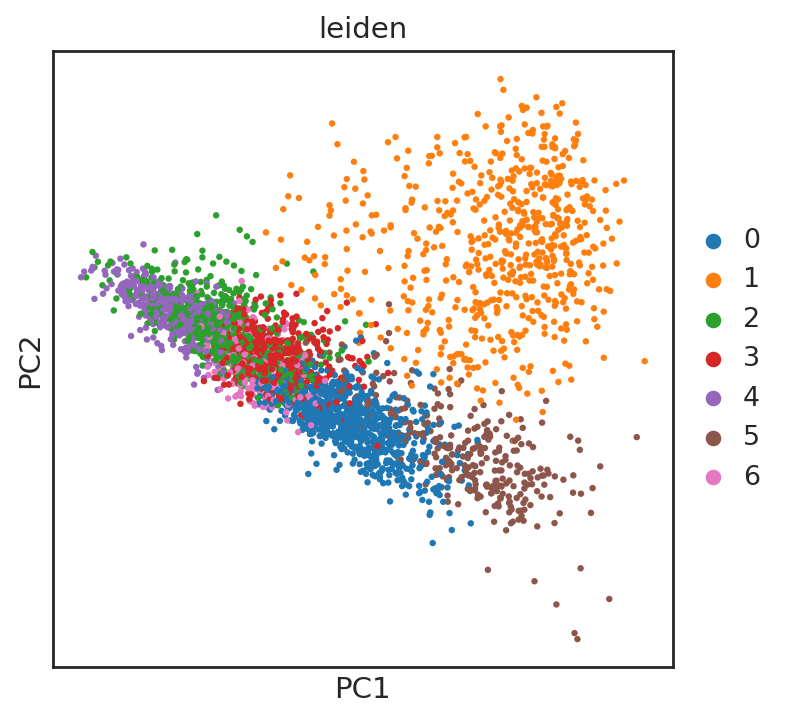

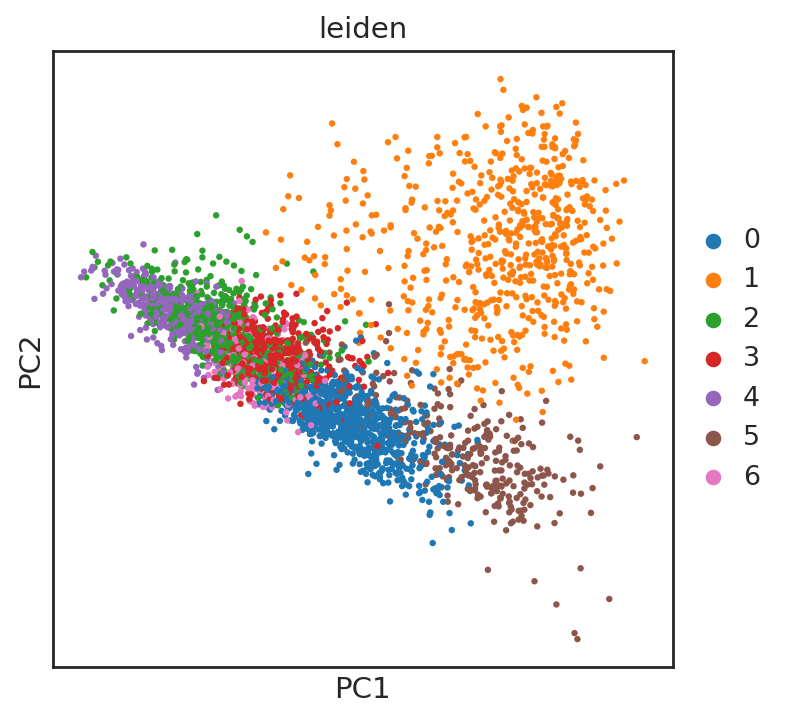

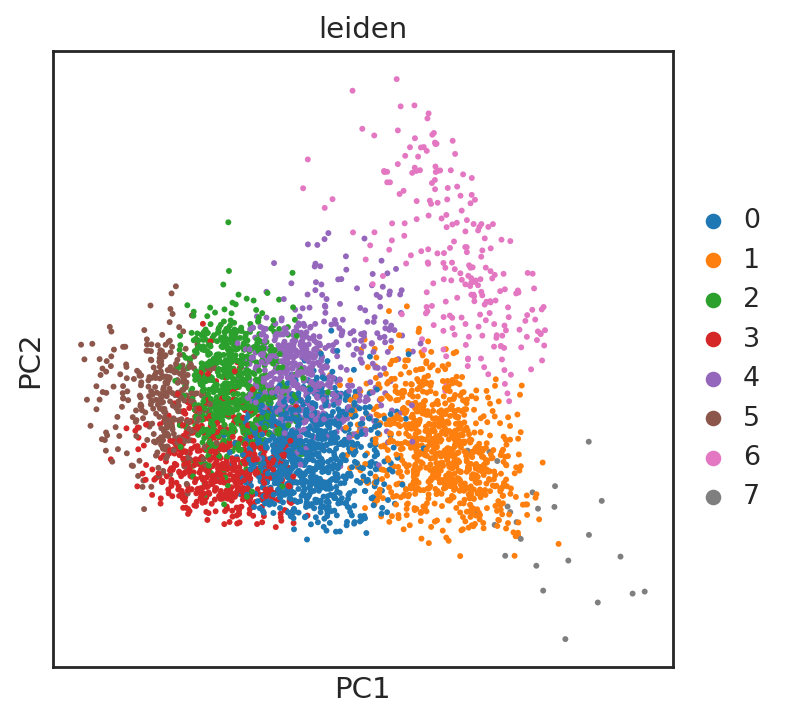

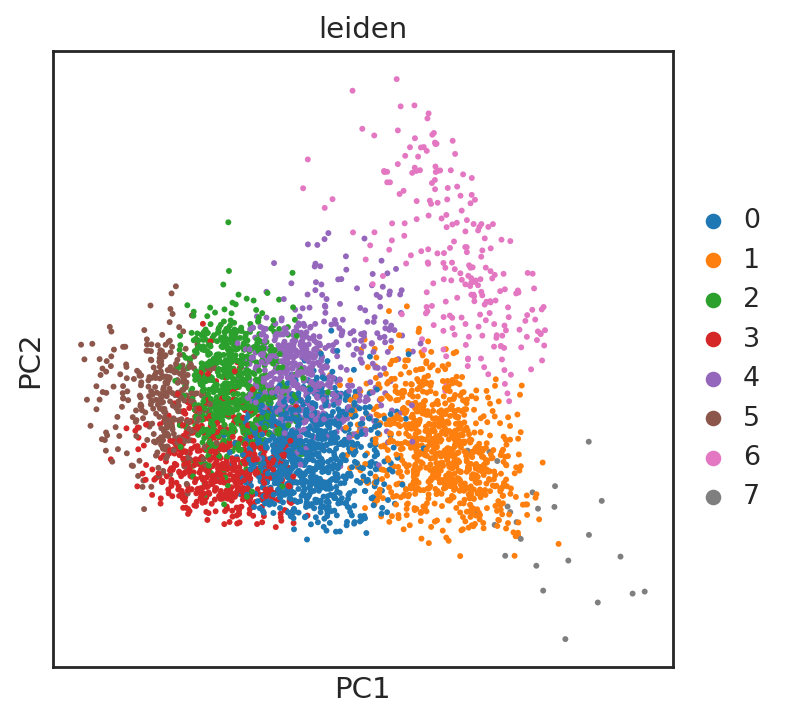

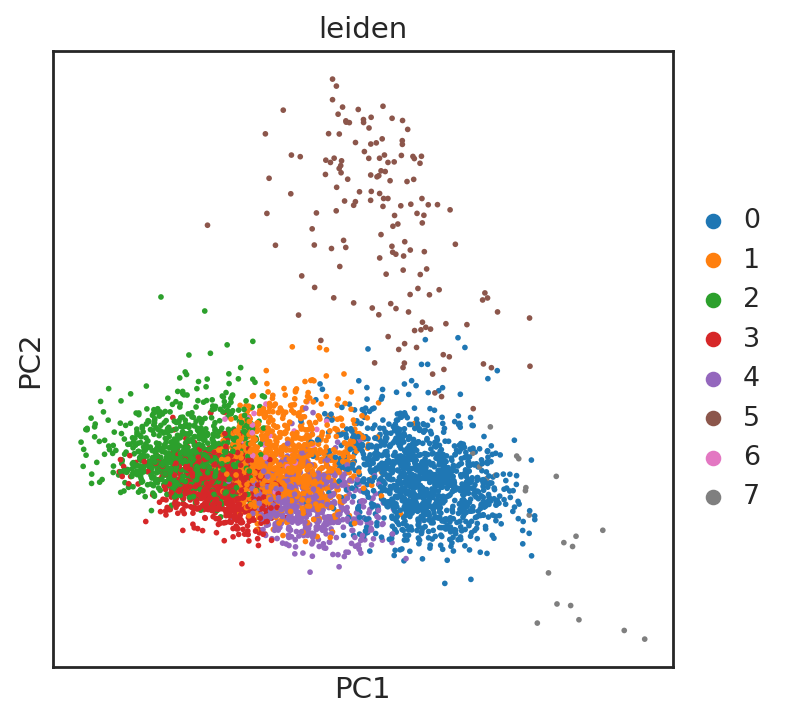

...

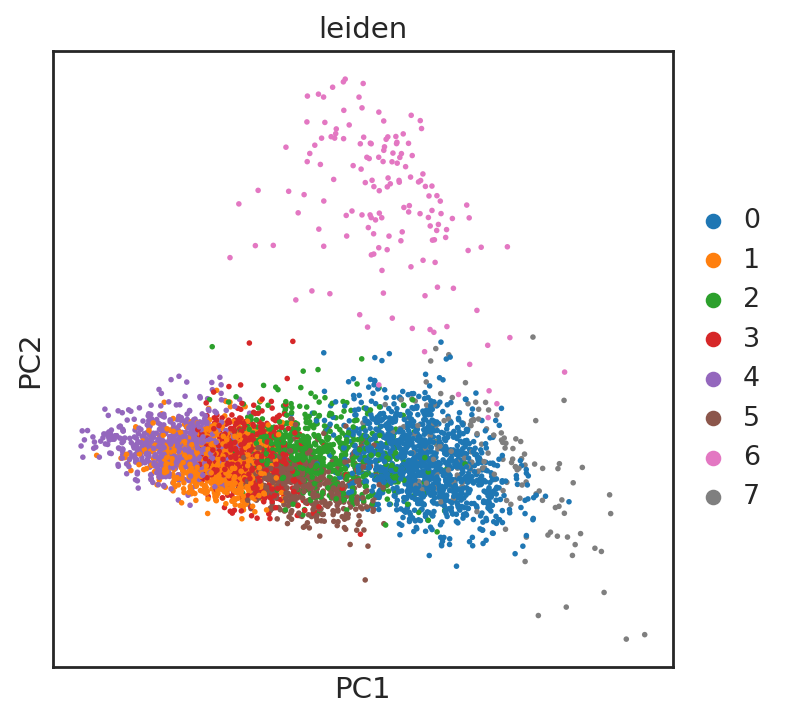

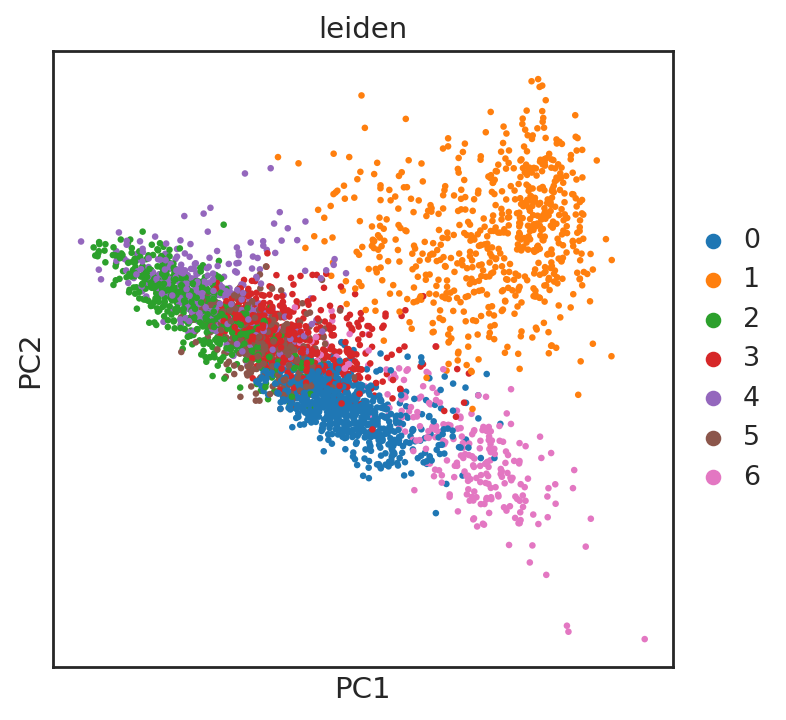

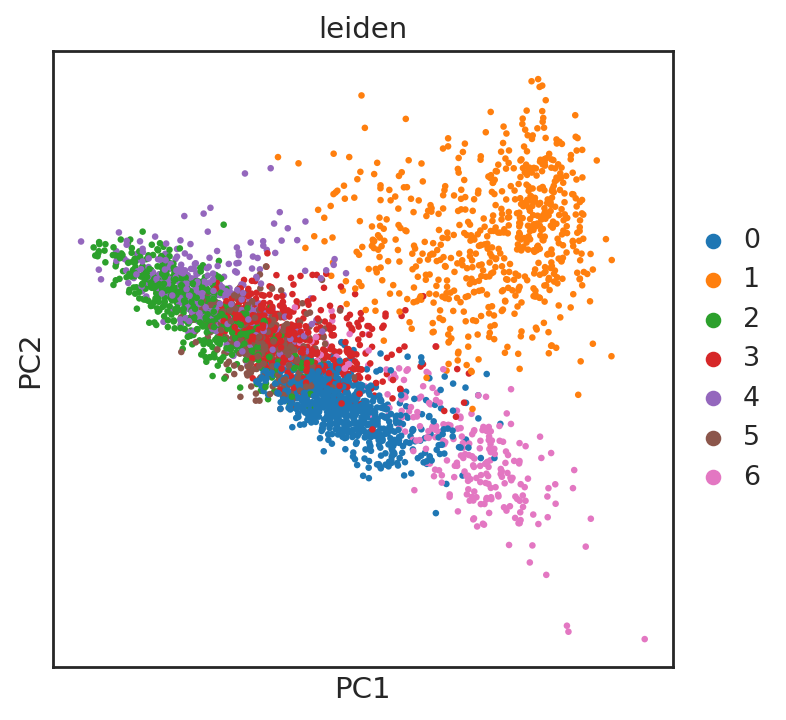

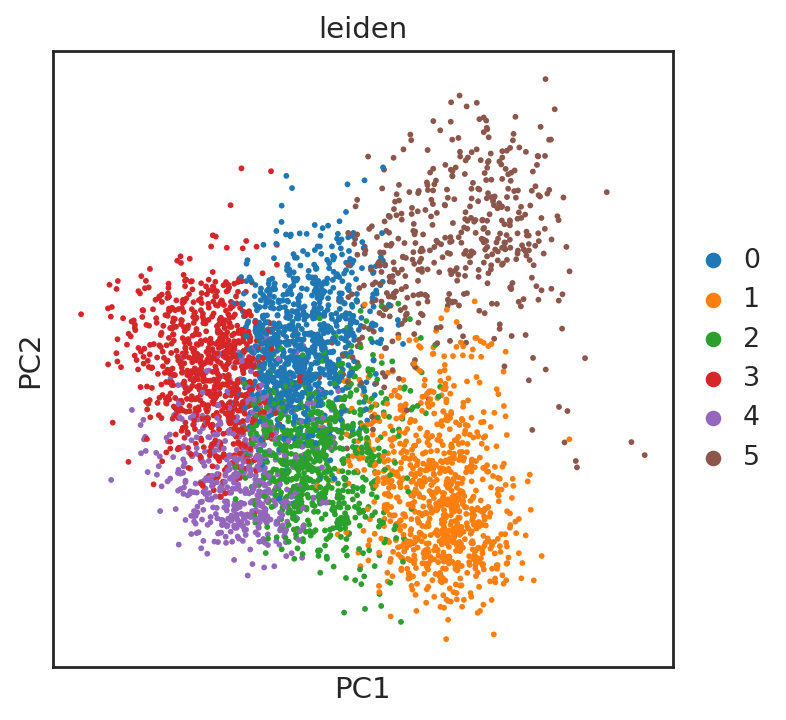

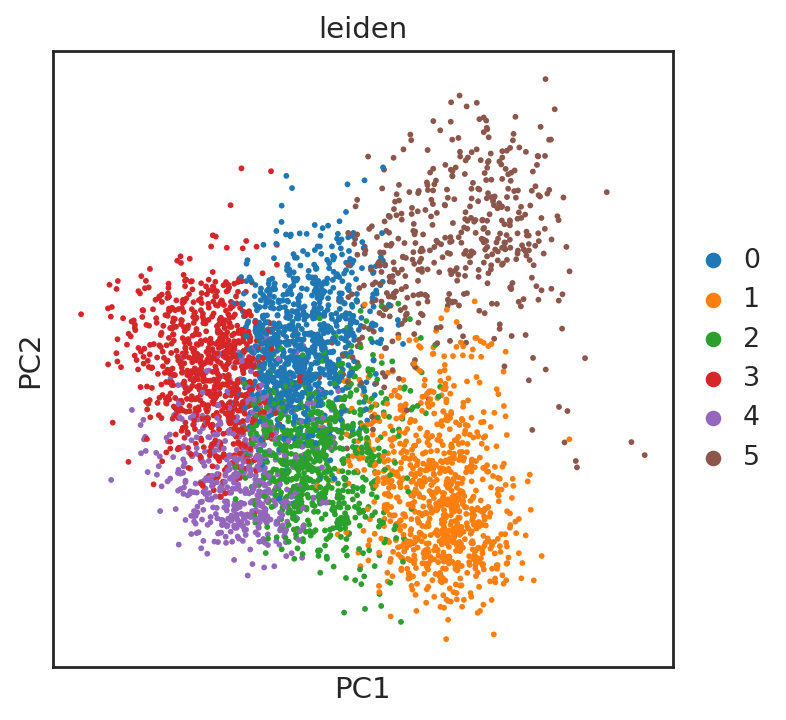

In [12]:
pca_output_df = generate_pca_figures(
    pca_output_df, # just gettign directory
    path_col='run_pca',
    fig_path='../results/00/pca_rna/PCA_LEIDEN',
    adata_color_col='leiden',
    fig_exts=['png', 'svg'],
    cell_embedding_adata_fn='PCA.adata_CG.h5ad',
    palette=leiden_palette,
)

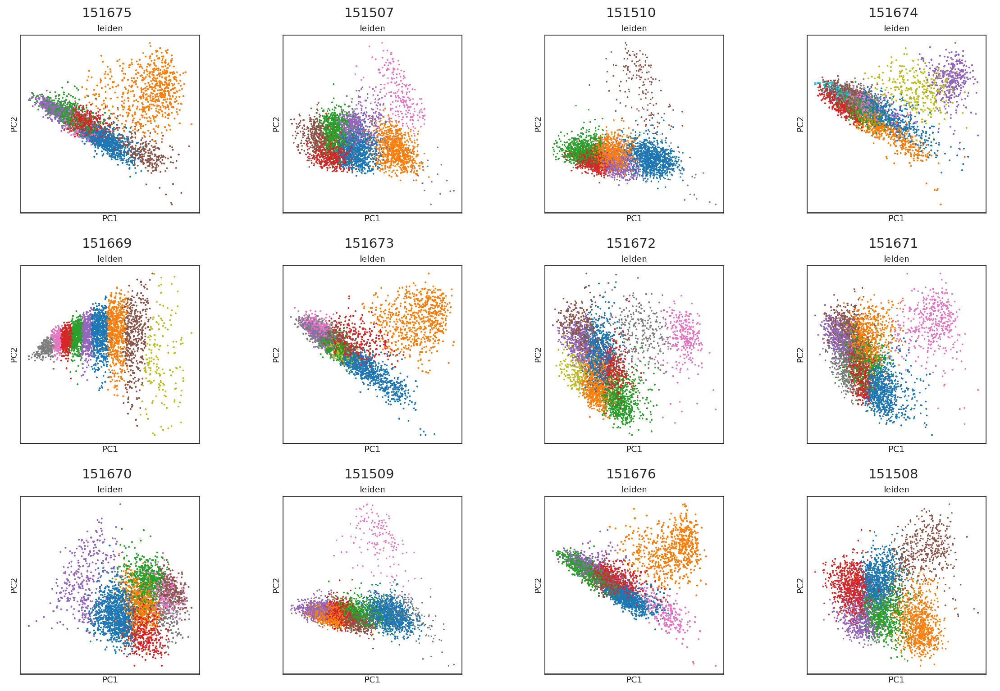

In [13]:
fig, axes = combine_images(
    performance_output_df, img_path_col='pca_fig_png',
    x_min=50,
    x_max=700,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

100%|██████████| 12/12 [00:03<00:00,  3.07it/s]


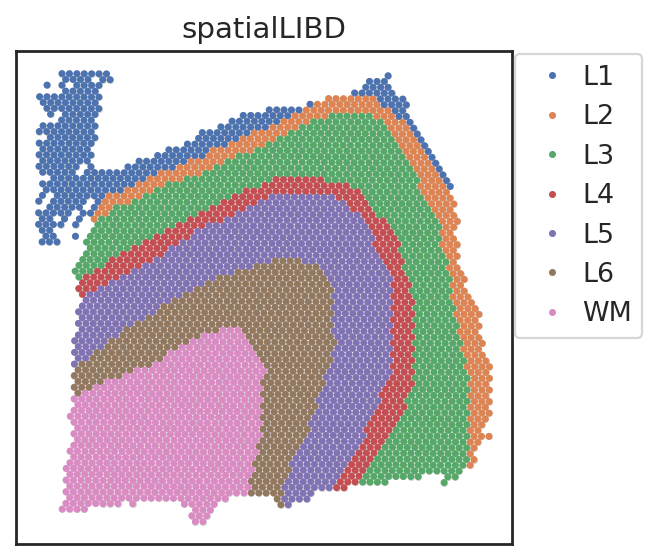

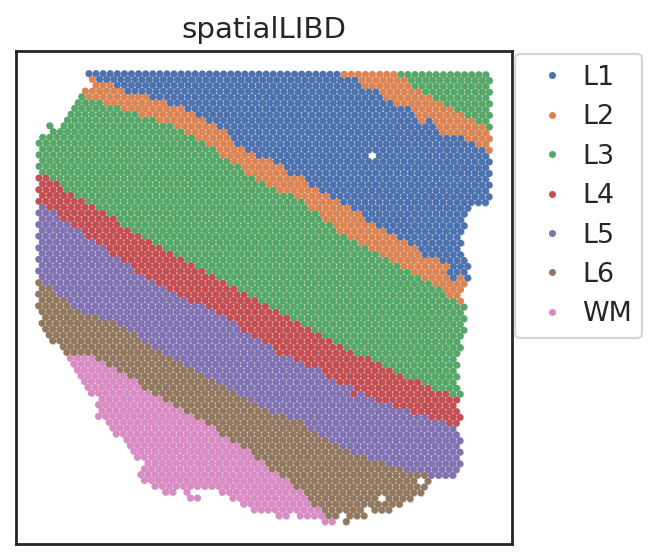

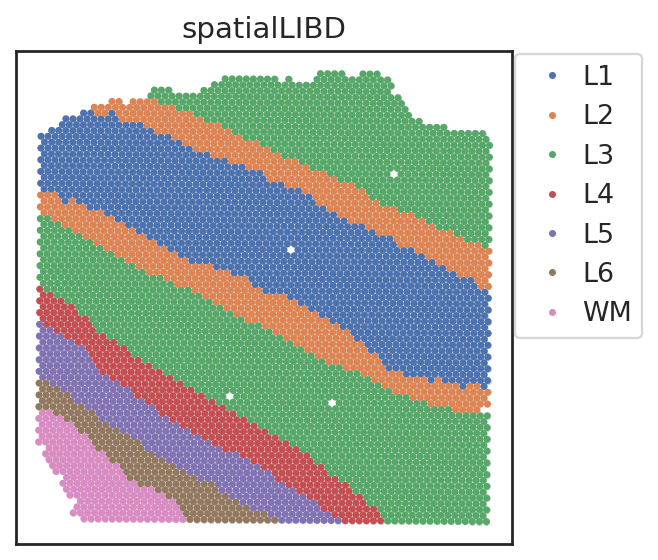

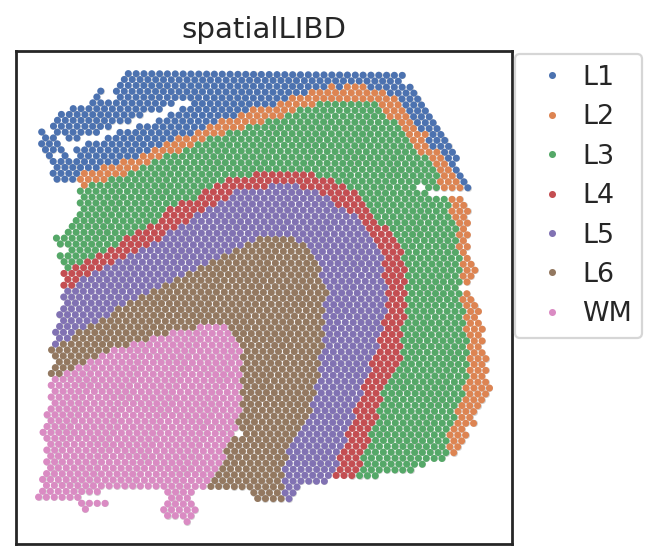

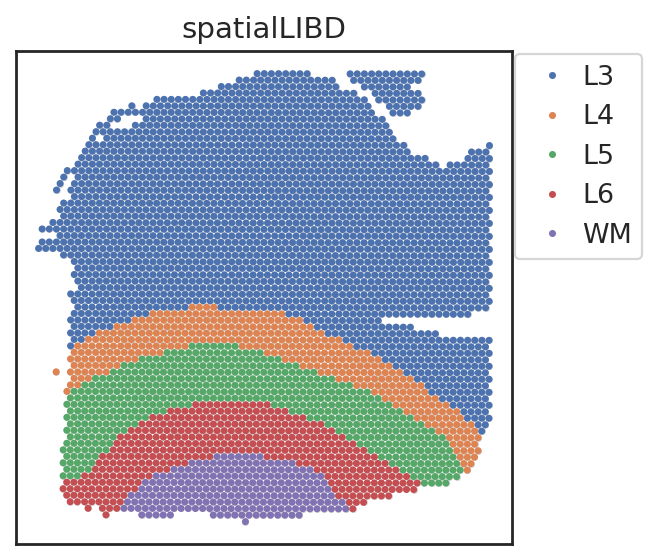

...

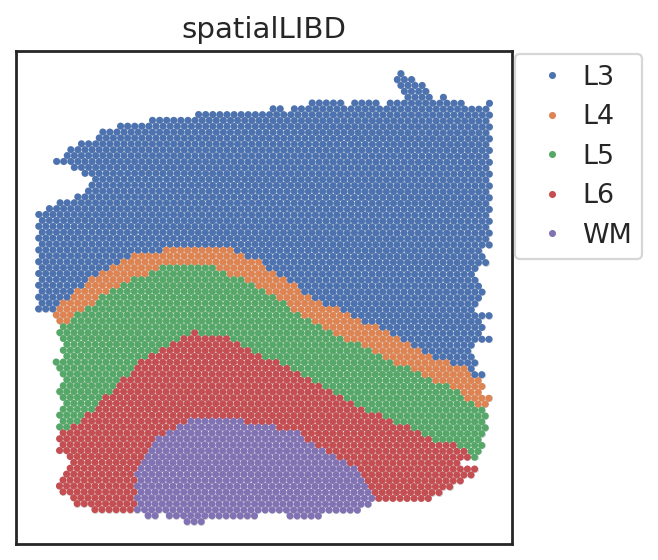

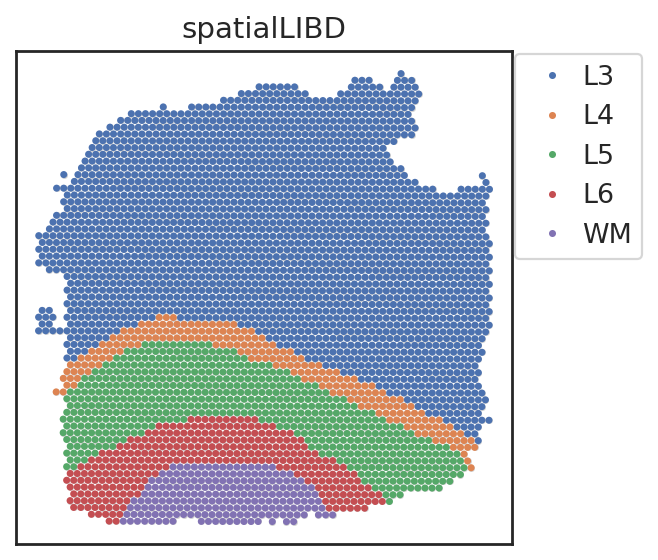

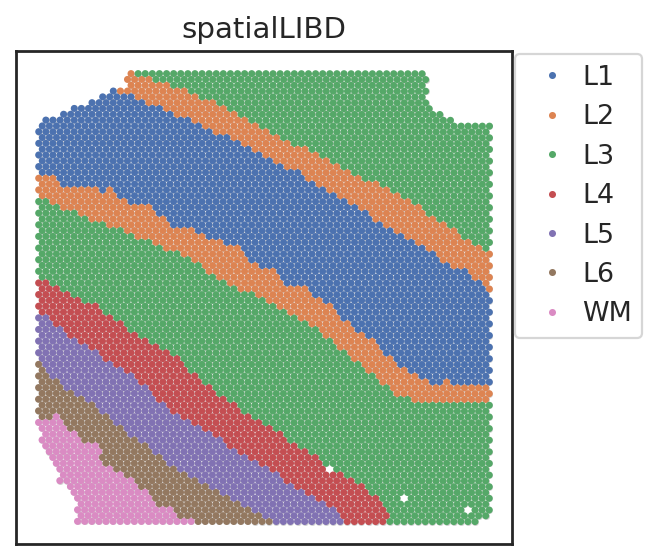

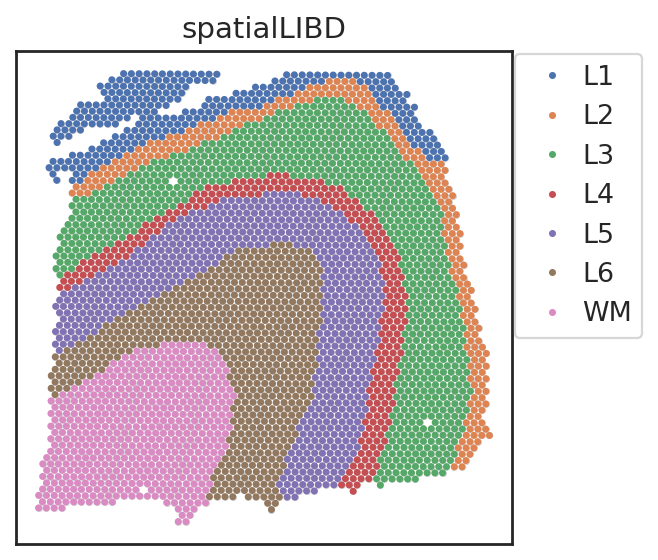

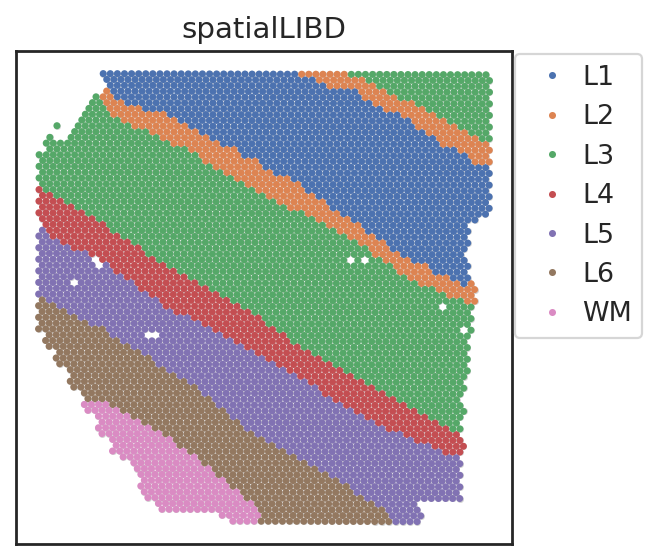

In [168]:
ground_truth_output_df = generate_spatial_figures(
    pca_output_df.copy(),
    path_col="run_pca",
    cell_embedding_adata_fn="PCA.adata_CG.h5ad",
    adata_spatial_dir="/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/data/human_DLPFC/", # directory with the spatial coordinates.e.g.  <sample_id>.h5ad
    fig_path = "../results/00/pca_rna/SPATIAL_GROUND_TRUTH",
    adata_color_col="spatialLIBD", # leiden, etc.
    fig_exts=["png"],
    s=10, 
    fig_ncol=1,
    linewidth=0
)

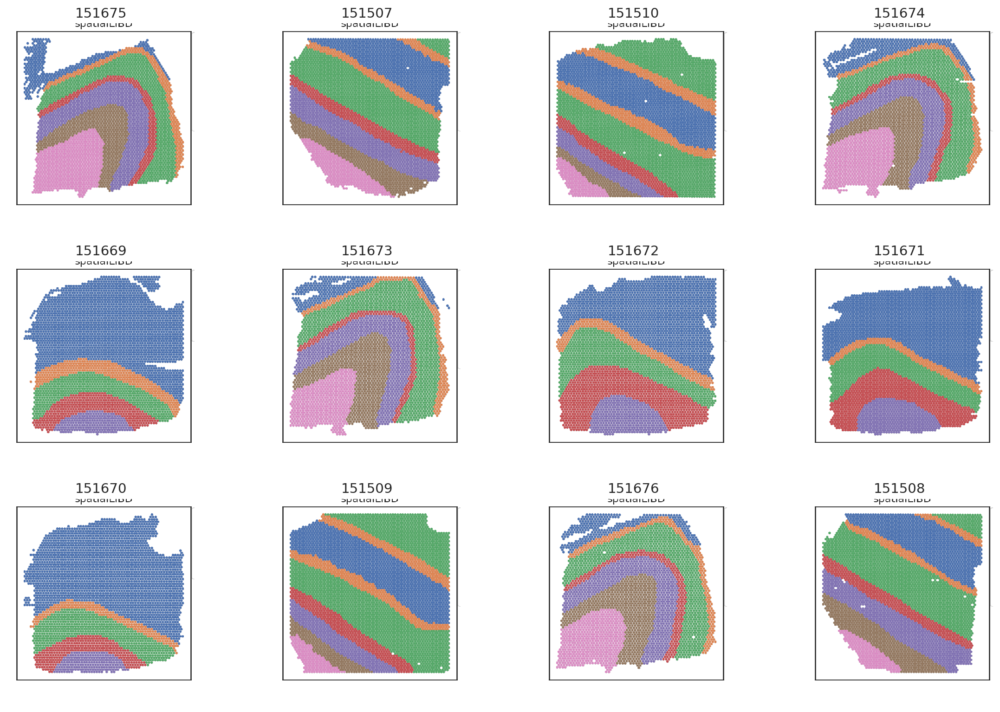

In [169]:
fig, axes = combine_images(
    ground_truth_output_df, img_path_col='spatial_fig_png',
    x_min=50,
    x_max=550,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

 25%|██▌       | 3/12 [00:00<00:03,  2.98it/s]

100%|██████████| 12/12 [00:04<00:00,  2.99it/s]


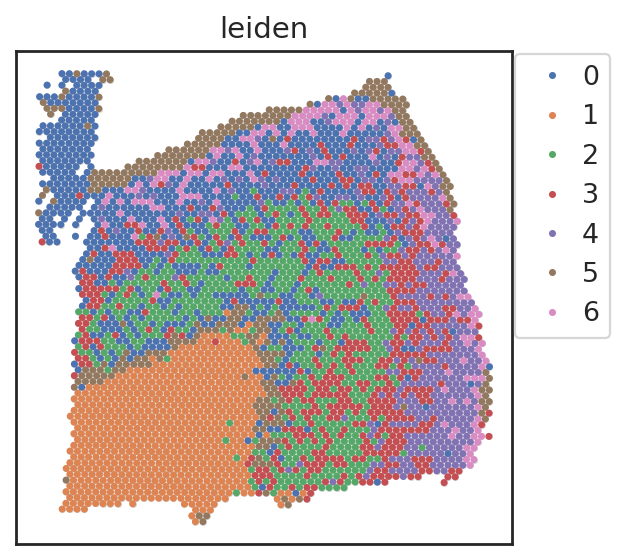

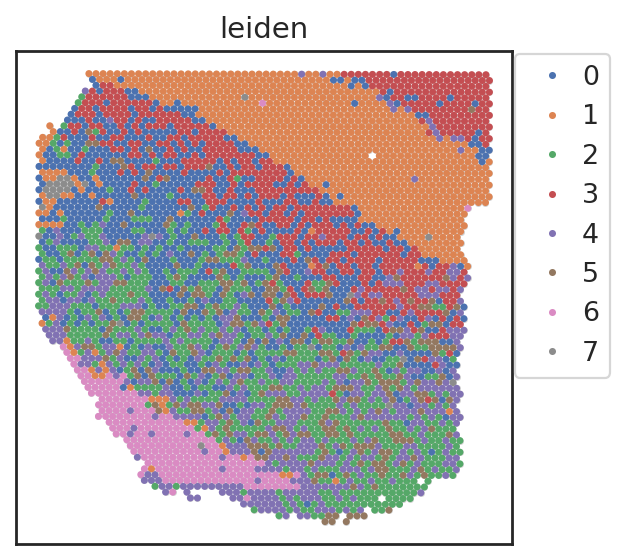

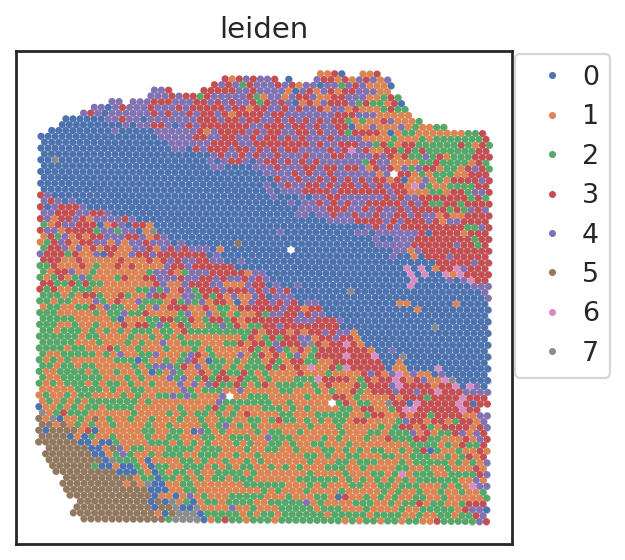

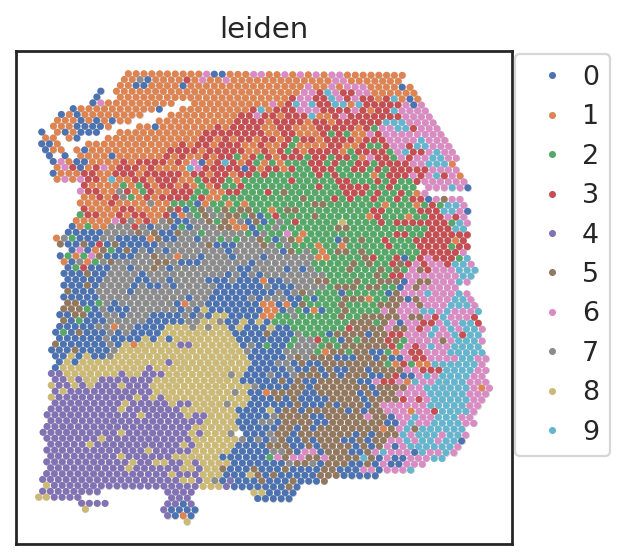

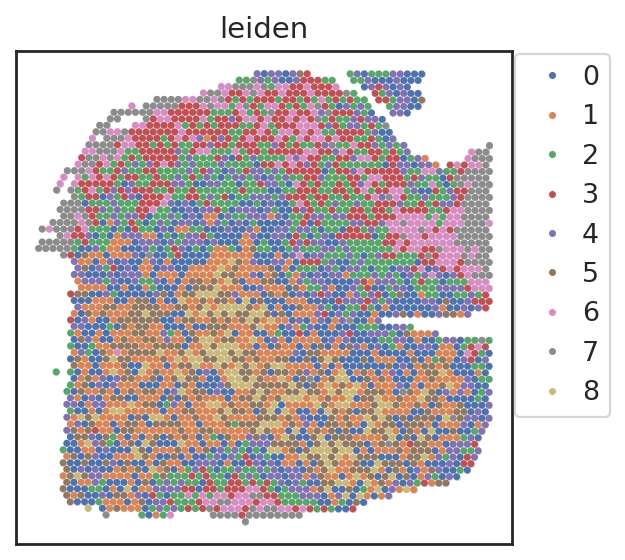

...

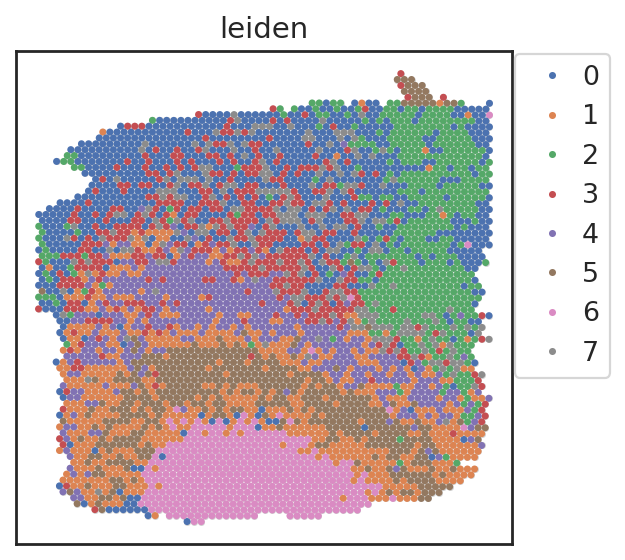

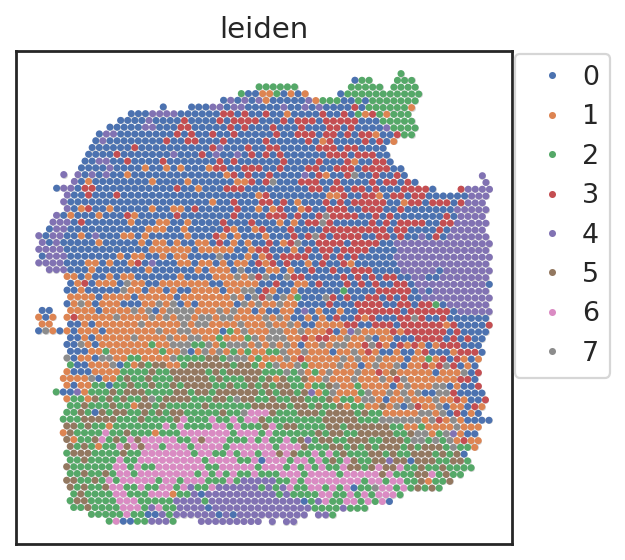

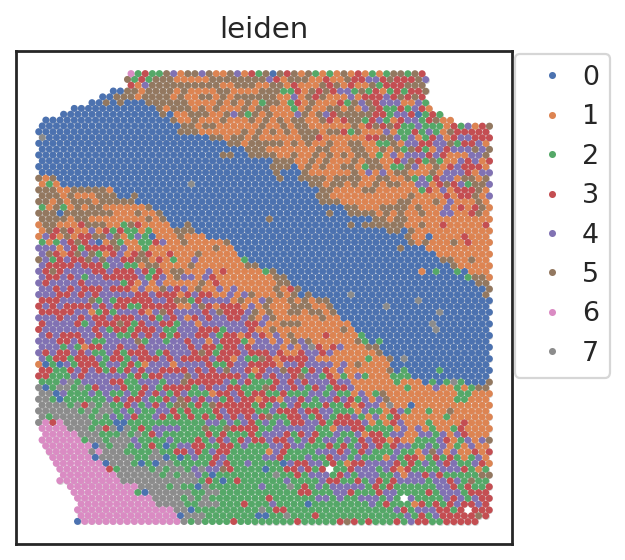

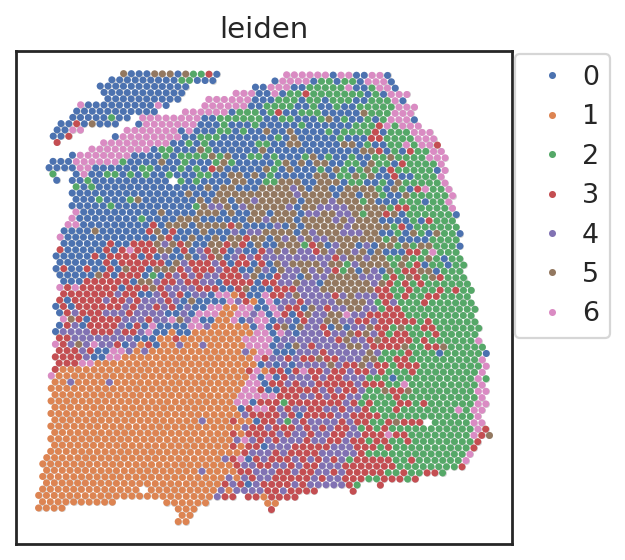

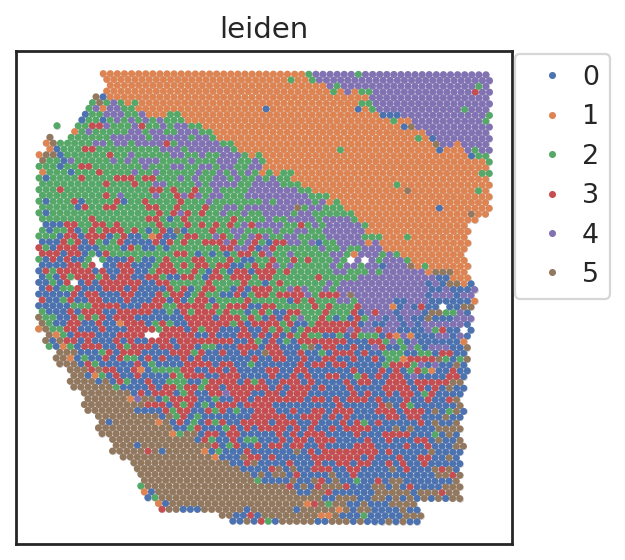

In [166]:
pca_output_df = generate_spatial_figures(
    pca_output_df,
    path_col="run_pca",
    cell_embedding_adata_fn="PCA.adata_CG.h5ad",
    adata_spatial_dir="/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/data/human_DLPFC/", # directory with the spatial coordinates.e.g.  <sample_id>.h5ad
    fig_path = "../results/00/pca_rna/SPATIAL_LEIDEN",
    adata_color_col="leiden", # leiden, etc.
    fig_exts=["png"],
    s=10, 
    fig_ncol=1,
    linewidth=0
)

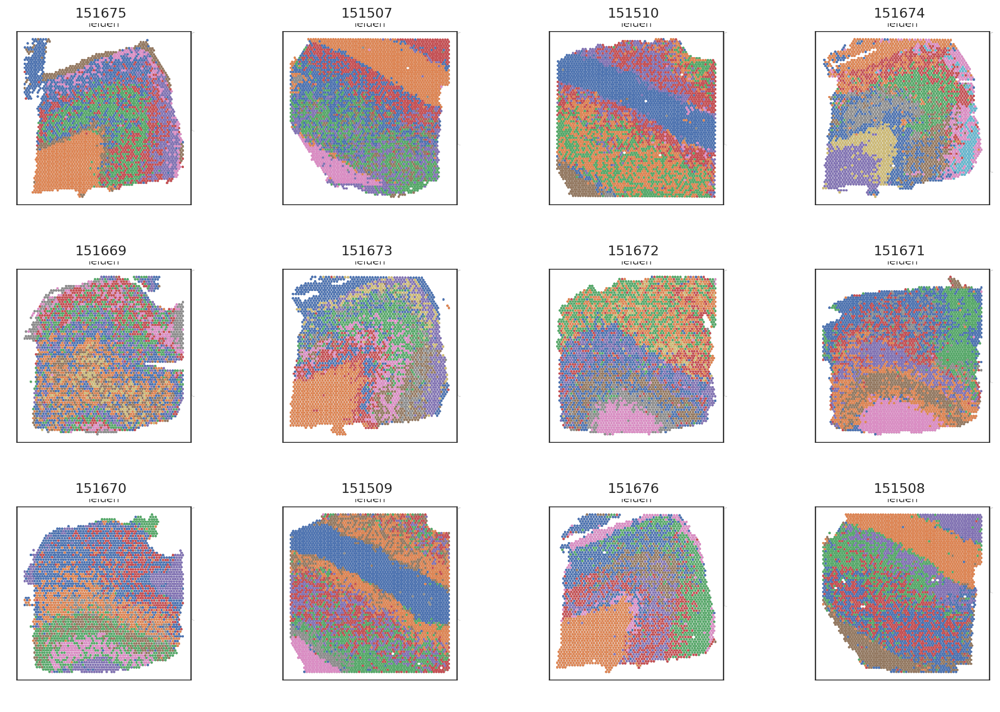

In [167]:
fig, axes = combine_images(
    pca_output_df, img_path_col='spatial_fig_png',
    x_min=50,
    x_max=550,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

# SpatialPCA

In [14]:
spatialpca_fn = '../results/00/spatialpca/spatialpca_adata_py.tsv'
spatialpca_output_df = pd.read_csv(spatialpca_fn, sep='\t', index_col=0)
spatialpca_output_df['spatialPCA_dir'] = spatialpca_output_df['spatialPCA_adata_fn'].apply(lambda x: x.rsplit("/", 1)[0])
spatialpca_output_df.head()

,spatialPCA_adata_fn,spatialPCA_dir
151507,../results/00/spatialpca/151507/spatialPCA_to_...,../results/00/spatialpca/151507
151508,../results/00/spatialpca/151508/spatialPCA_to_...,../results/00/spatialpca/151508
151509,../results/00/spatialpca/151509/spatialPCA_to_...,../results/00/spatialpca/151509
151510,../results/00/spatialpca/151510/spatialPCA_to_...,../results/00/spatialpca/151510
151669,../results/00/spatialpca/151669/spatialPCA_to_...,../results/00/spatialpca/151669


In [15]:
spatialPCA_performance_fn = "../results/00/pca_rna/spatialpca.spatialpca_adata_py.performance.tsv"
spatialPCA_performance_fn

'../results/00/pca_rna/spatialpca.spatialpca_adata_py.performance.tsv'

In [32]:
run_leiden_clustering(
    adata_output_df=spatialpca_output_df,
    path_col="spatialPCA_dir",
    cell_embedding_adata_fn="spatialPCA_to_py.adata.h5ad",
    performance_output_fn=spatialPCA_performance_fn,
    version='PCA'
)

  0%|          | 0/12 [00:00<?, ?it/s]/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/scripts/benchmarking/cluster.py:55: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  pc_adata = ad.AnnData(
  8%|▊         | 1/12 [00:05<00:55,  5.02s/it]/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/scripts/benchmarking/cluster.py:55: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  pc_adata = ad.AnnData(
 17%|█▋        | 2/12 [00:10<00:54,  5.46s/it]/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/scripts/benchmarking/cluster.py:55: FutureWarning: X

In [173]:
spatialPCA_performance_df = pd.read_csv(spatialPCA_performance_fn, sep='\t', index_col=0)
spatialPCA_performance_df.head()

,silhoutte,ARI,NMI,pca_adata_fn
151507,0.167494,0.229177,0.512178,../results/00/spatialpca/151507/PCA.spatialPCA...
151508,0.136837,0.182893,0.508099,../results/00/spatialpca/151508/PCA.spatialPCA...
151509,0.159860,0.151822,0.475197,../results/00/spatialpca/151509/PCA.spatialPCA...
151510,0.143949,0.144681,0.449216,../results/00/spatialpca/151510/PCA.spatialPCA...
151669,0.157338,0.093281,0.405780,../results/00/spatialpca/151669/PCA.spatialPCA...


 83%|████████▎ | 10/12 [00:07<00:01,  1.38it/s]/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_simba_only/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:262: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure()
100%|██████████| 12/12 [00:09<00:00,  1.30it/s]


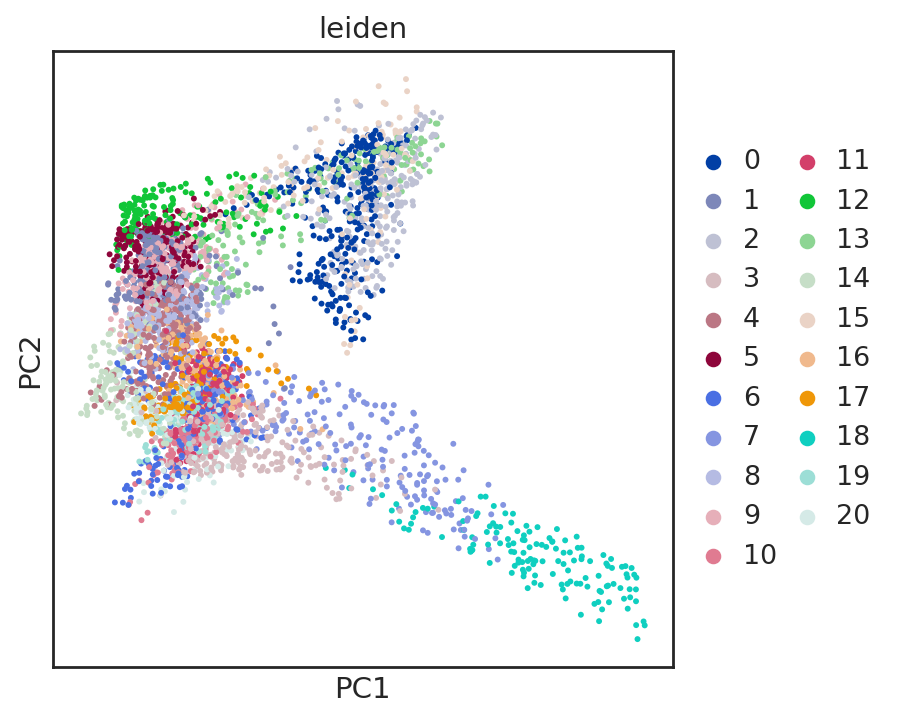

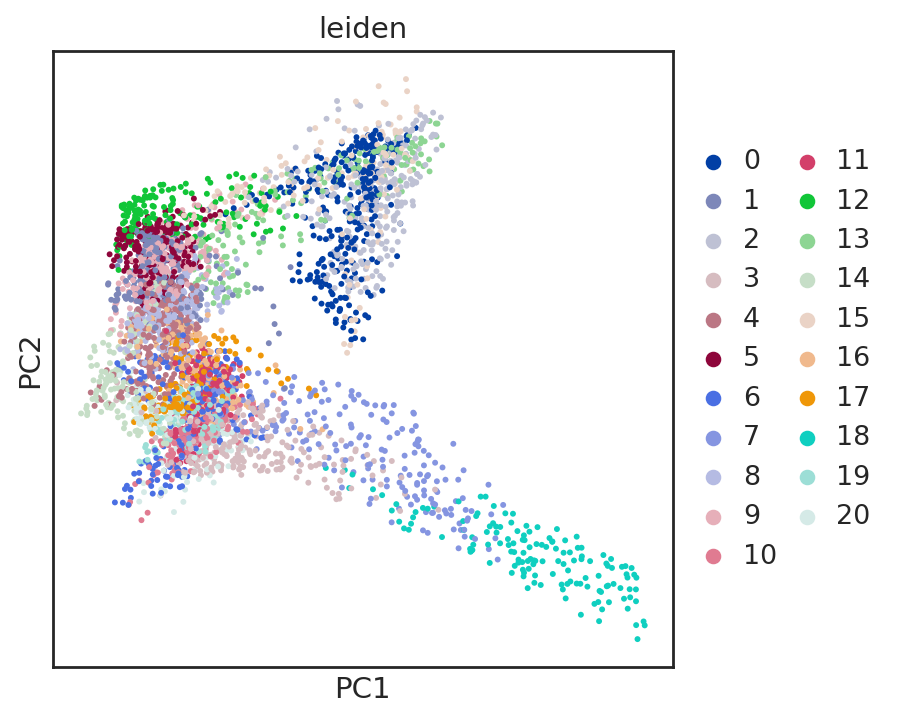

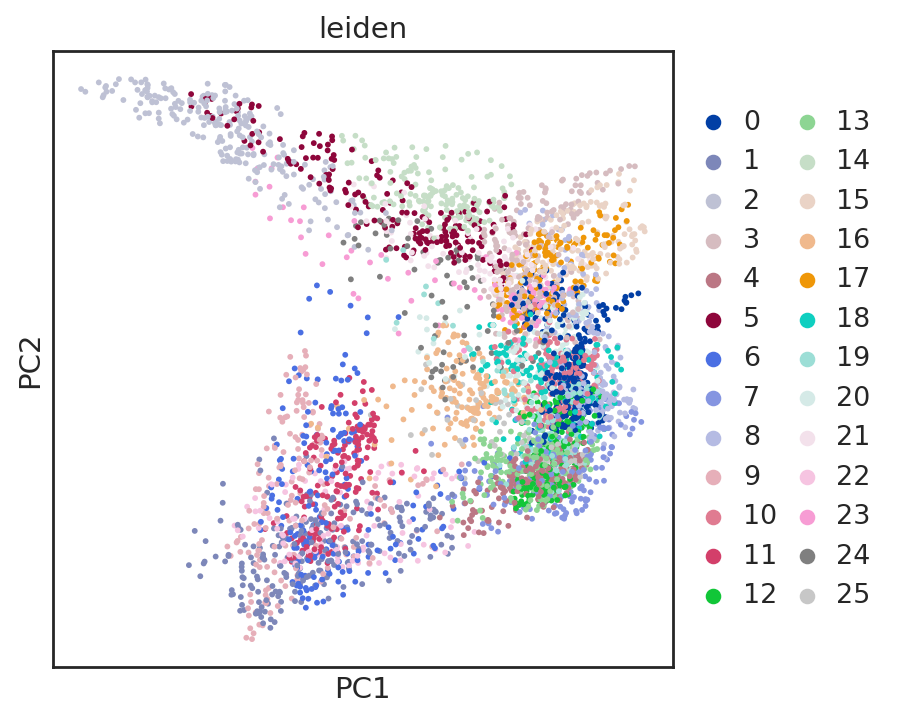

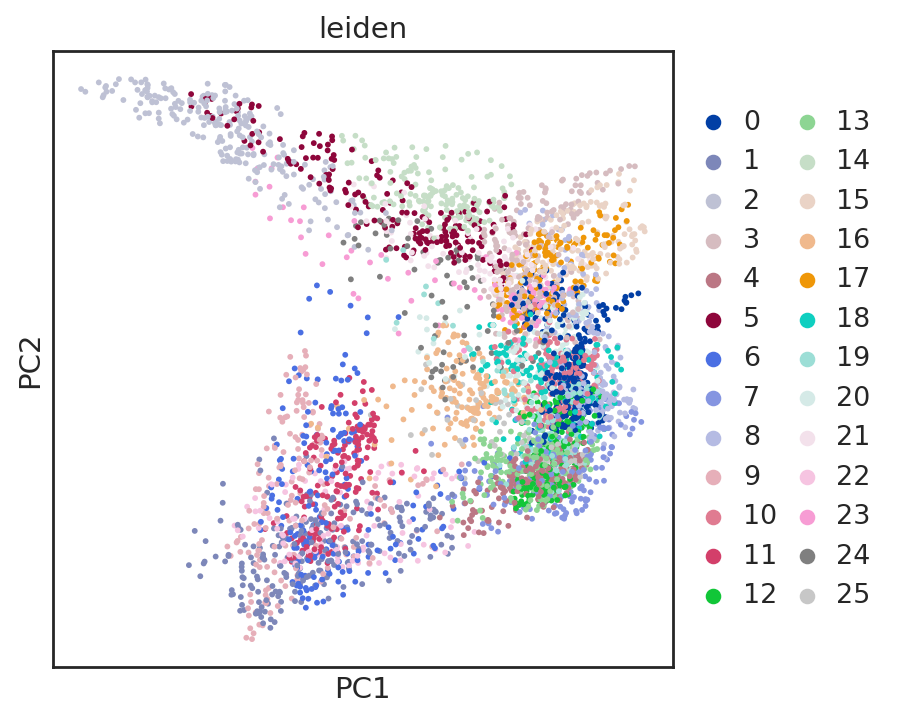

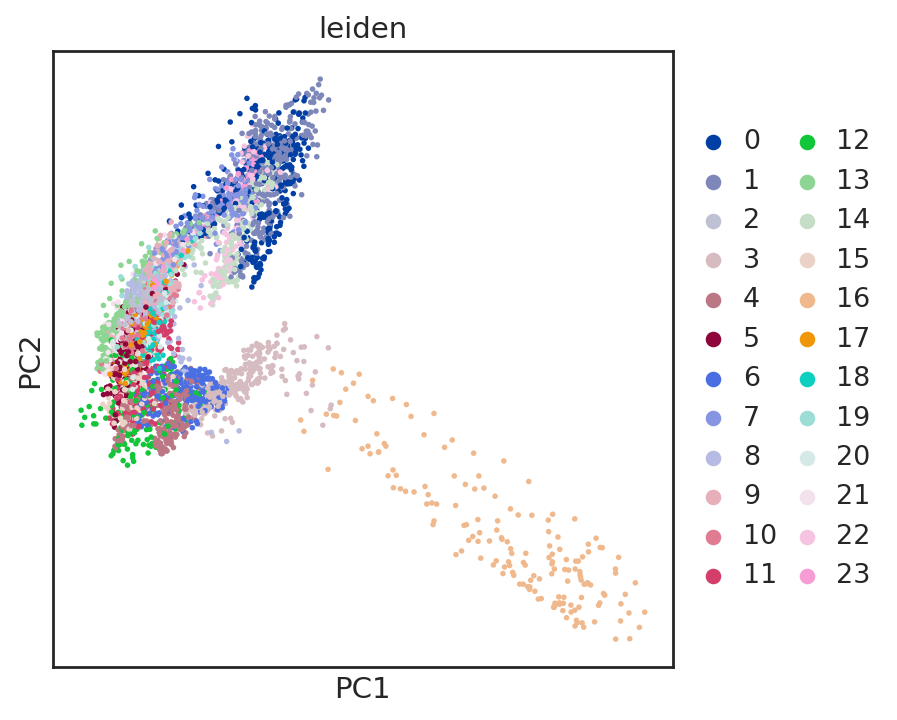

...

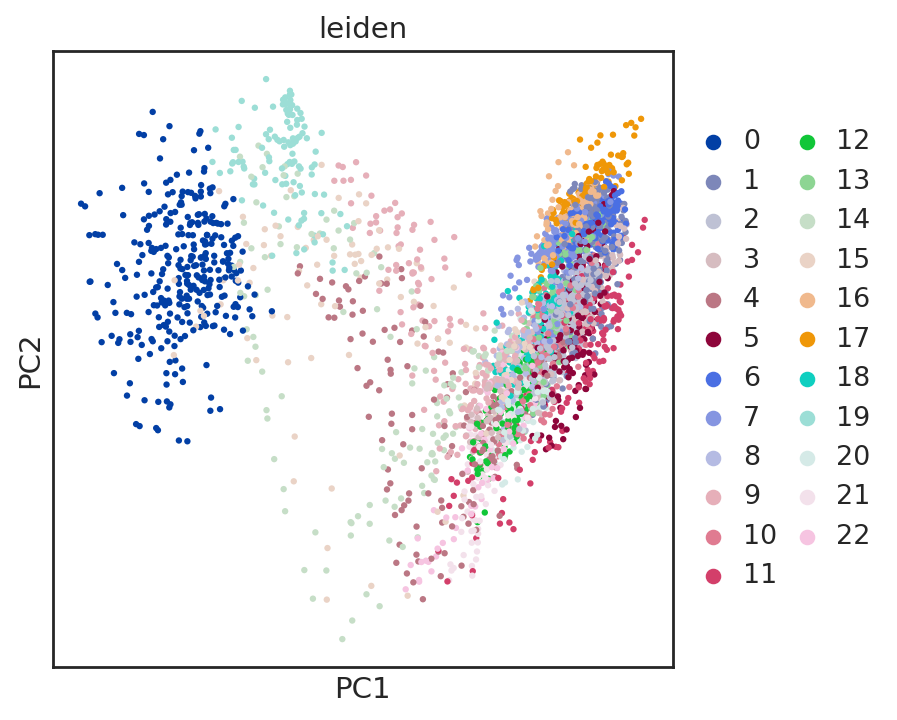

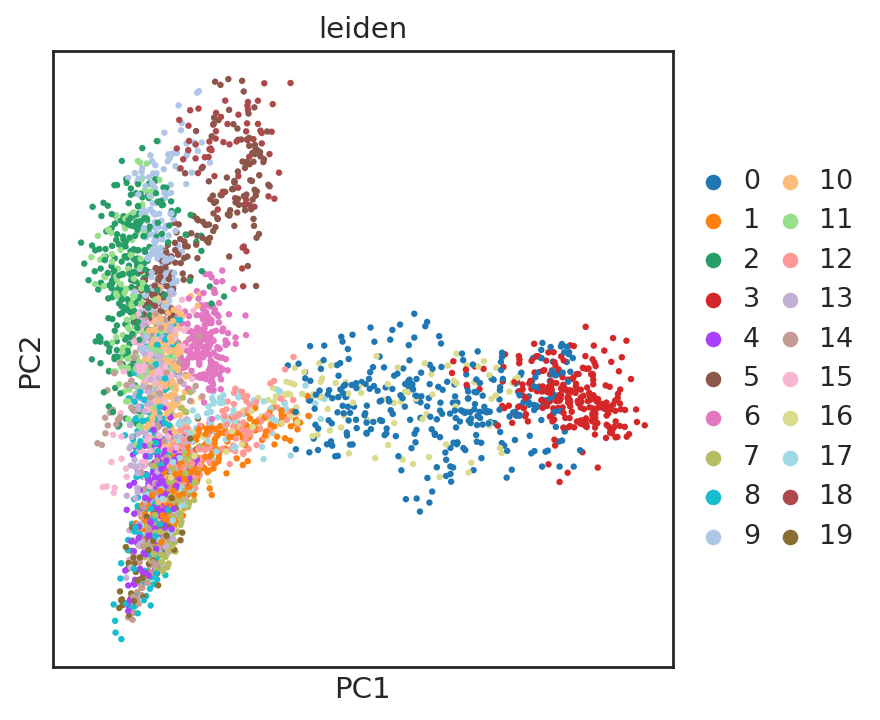

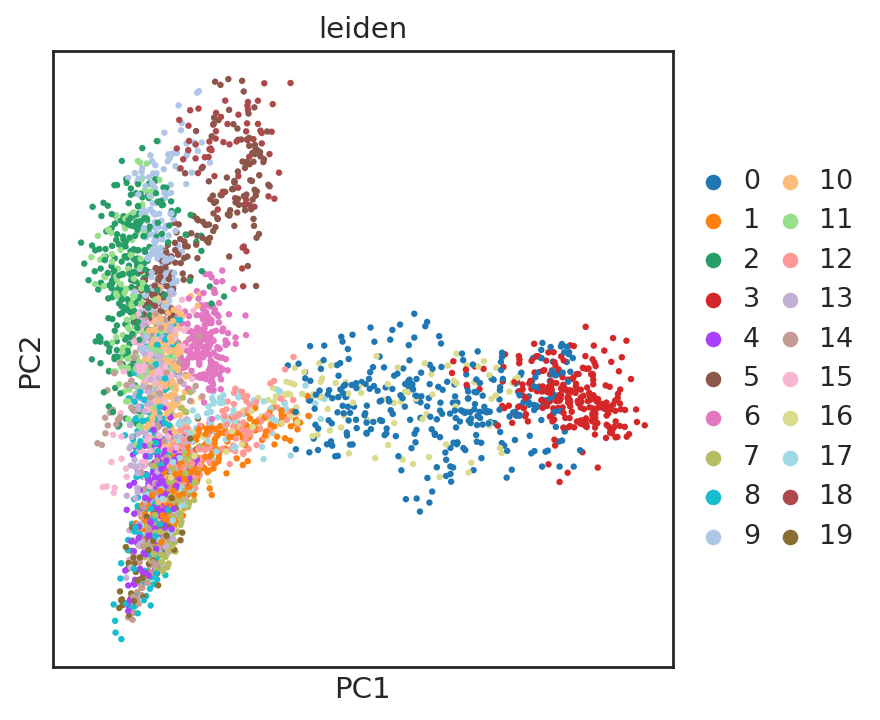

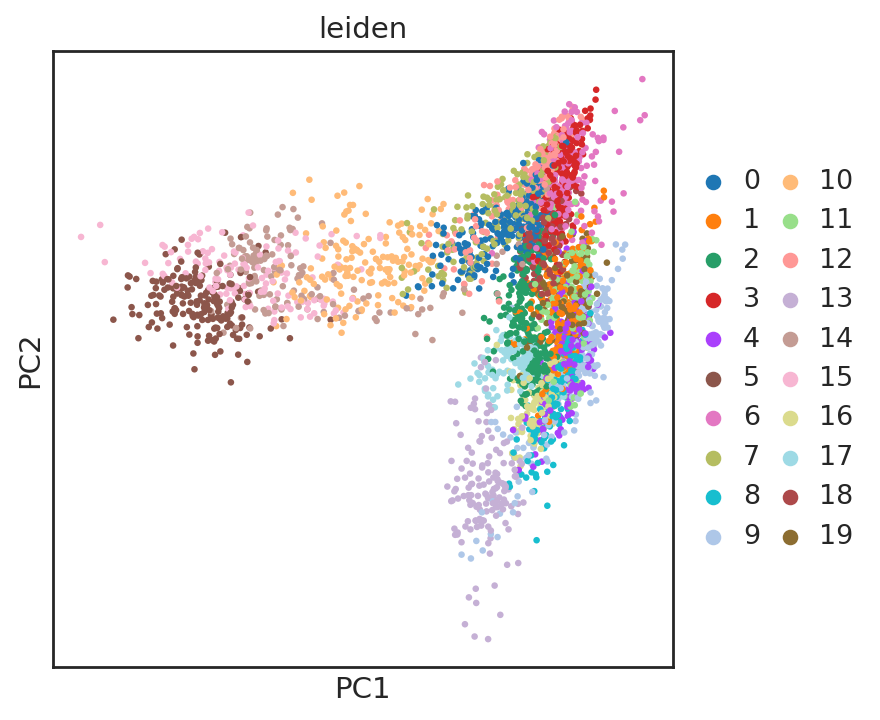

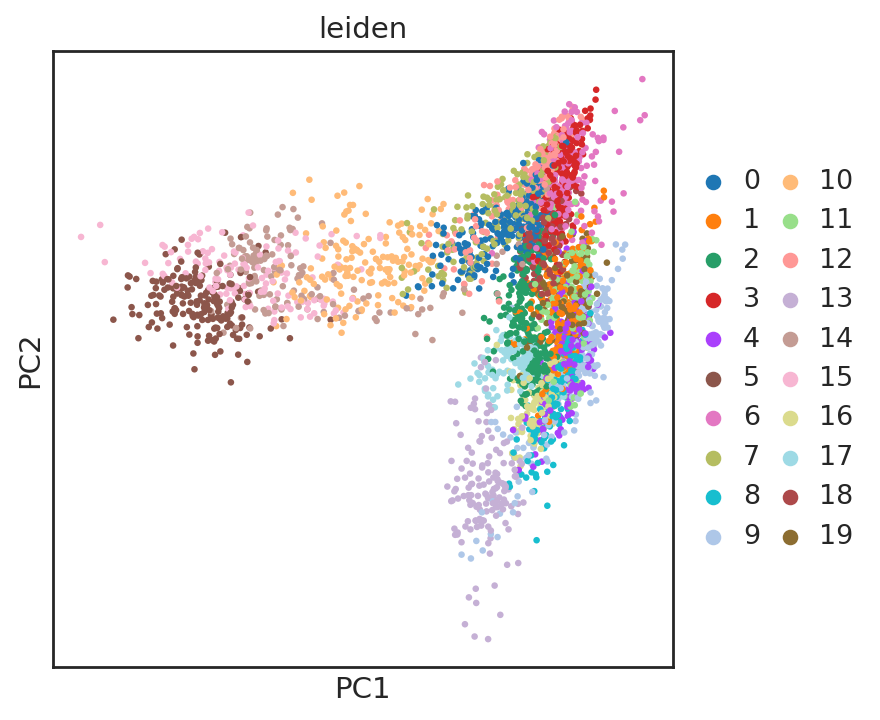

In [36]:
spatialPCA_performance_df = generate_pca_figures(
    spatialpca_output_df, # just getting directory
    path_col='spatialPCA_dir',
    fig_path='../results/00/spatialpca/PCA_LEIDEN',
    adata_color_col='leiden',
    fig_exts=['png', 'svg'],
    cell_embedding_adata_fn='PCA.spatialPCA_to_py.adata.h5ad',
    palette=None, #leiden_palette,
)

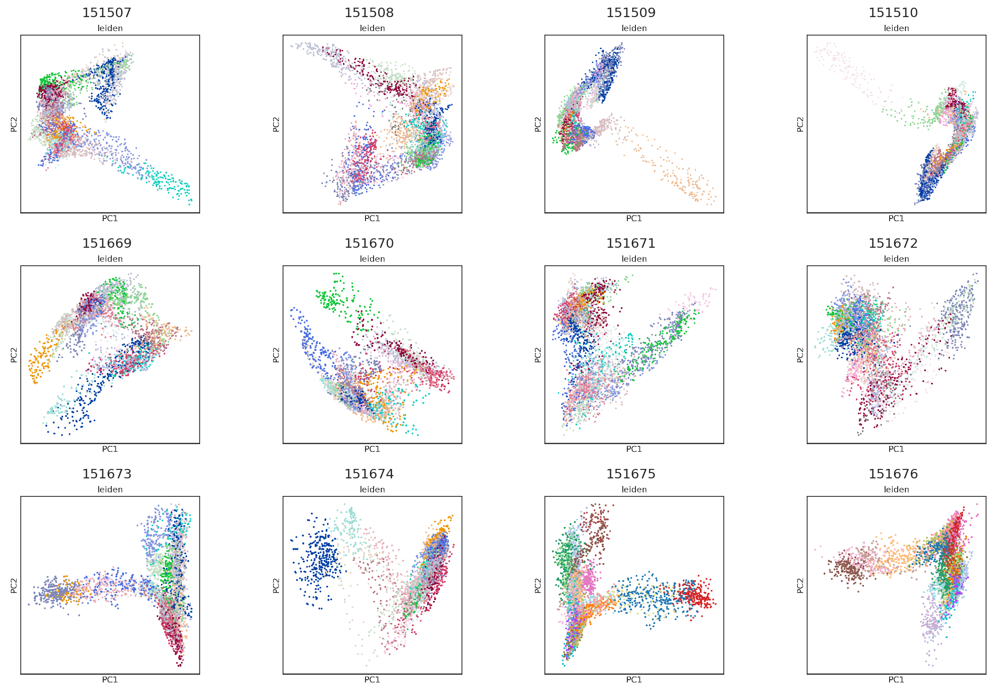

In [41]:
fig, axes = combine_images(
    spatialpca_output_df, img_path_col='pca_fig_png',
    x_min=50,
    x_max=700,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

In [150]:
spatialpca_output_df['spatialPCA_adata_fn'].tolist()

['../results/00/spatialpca/151507/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151508/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151509/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151510/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151669/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151670/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151671/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151672/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151673/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151674/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151675/spatialPCA_to_py.adata.h5ad',
 '../results/00/spatialpca/151676/spatialPCA_to_py.adata.h5ad']

100%|██████████| 12/12 [00:05<00:00,  2.30it/s]


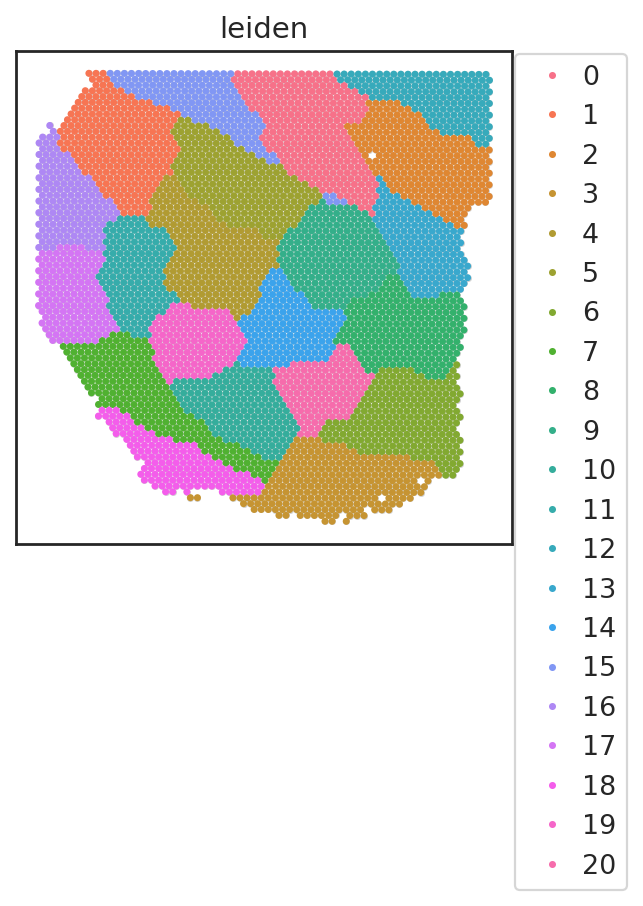

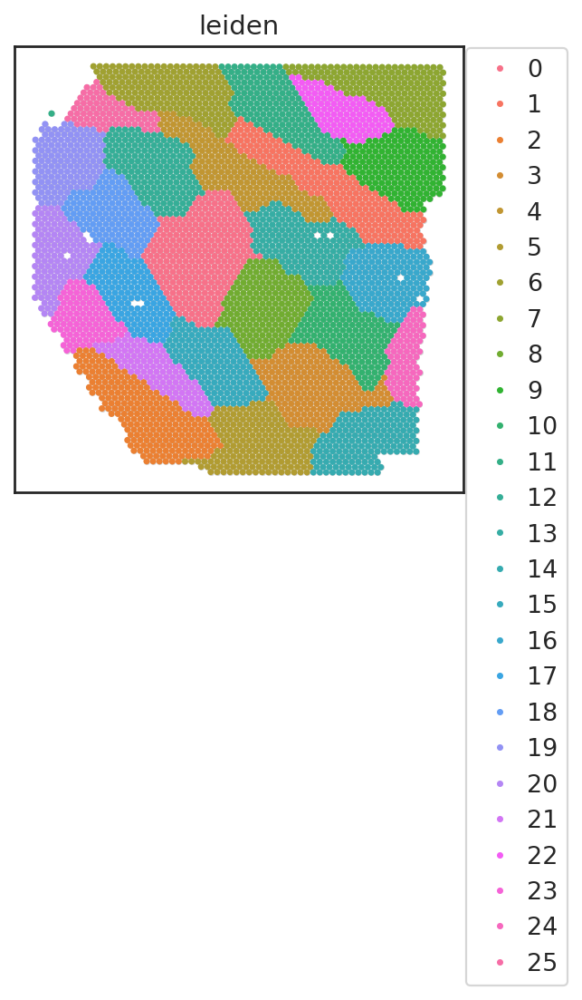

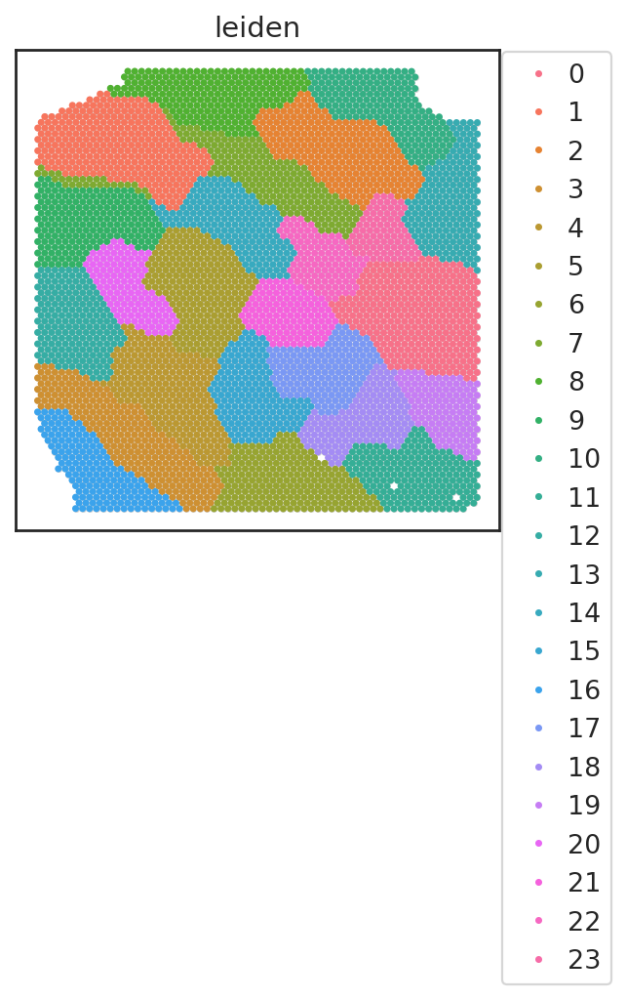

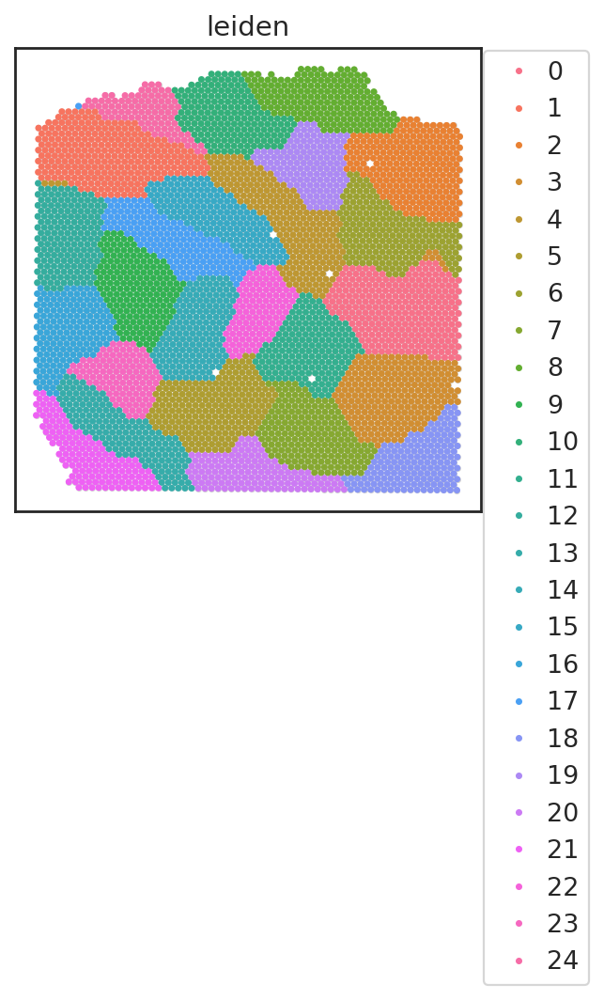

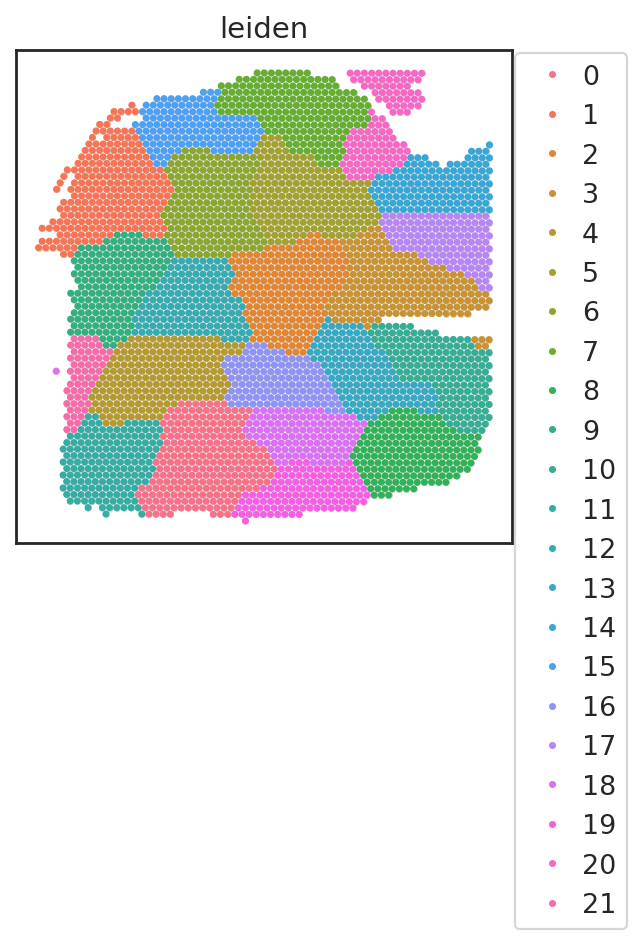

...

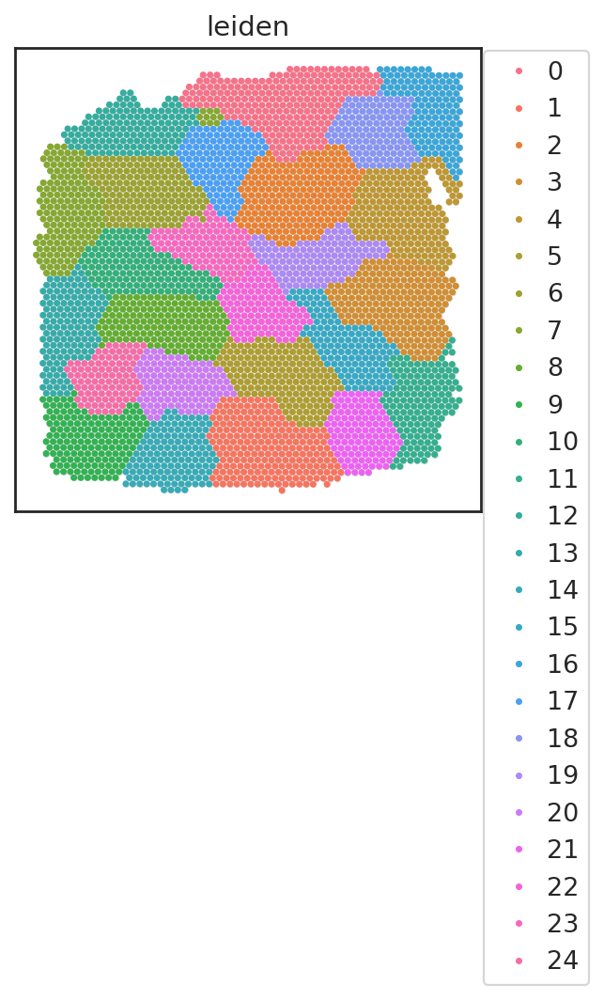

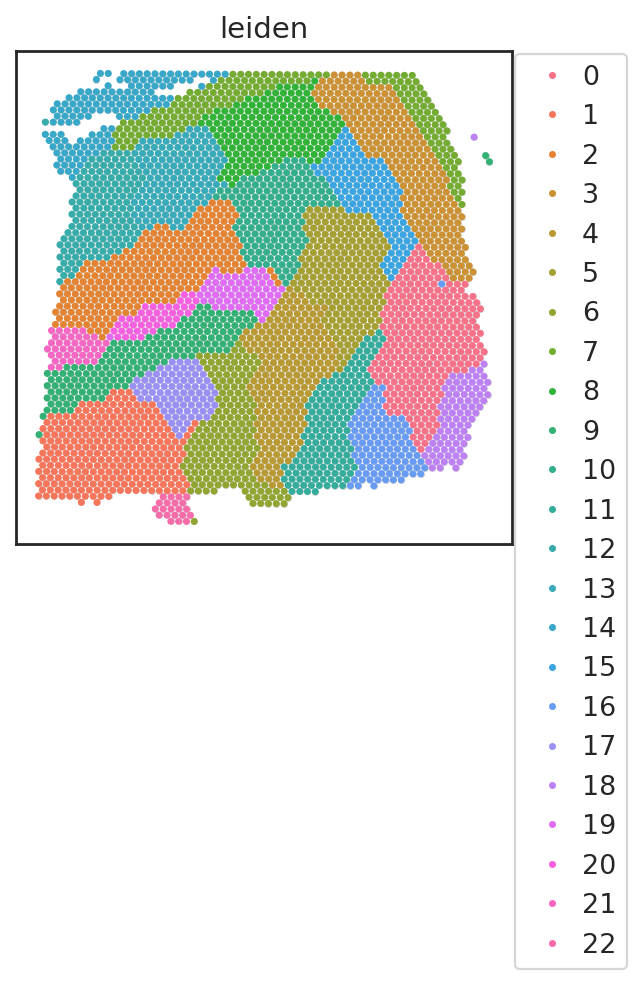

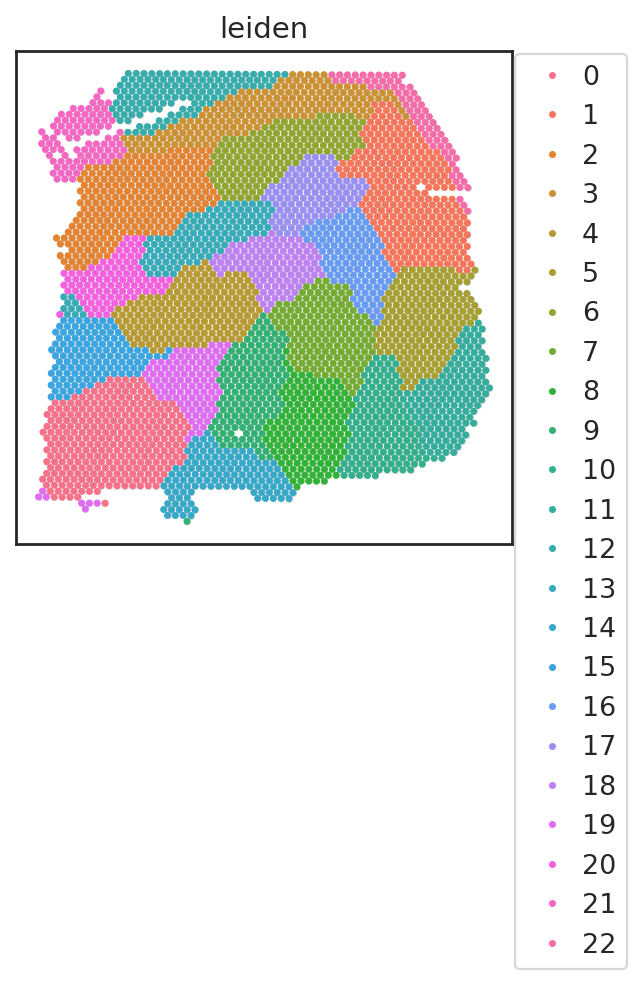

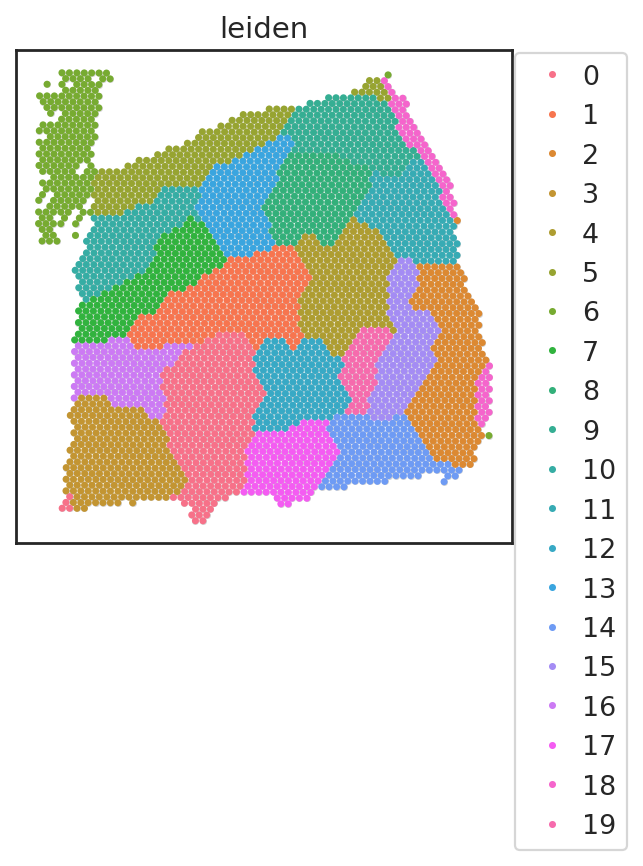

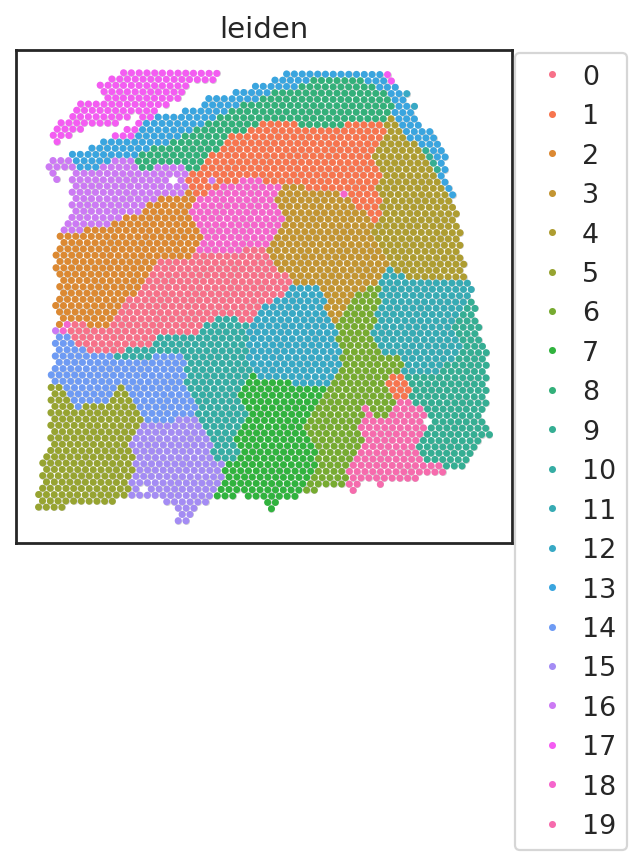

In [151]:
spatialpca_output_df = generate_spatial_figures(
    spatialpca_output_df,
    path_col="spatialPCA_dir",
    cell_embedding_adata_fn="PCA.spatialPCA_to_py.adata.h5ad",
    adata_spatial_dir="/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/data/human_DLPFC/", # directory with the spatial coordinates.e.g.  <sample_id>.h5ad
    fig_path = "../results/00/spatialpca/SPATIAL_LEIDEN",
    adata_color_col="leiden", # leiden, etc.
    fig_exts=["png"],
    s=10, 
    fig_ncol=1,
    linewidth=0
)

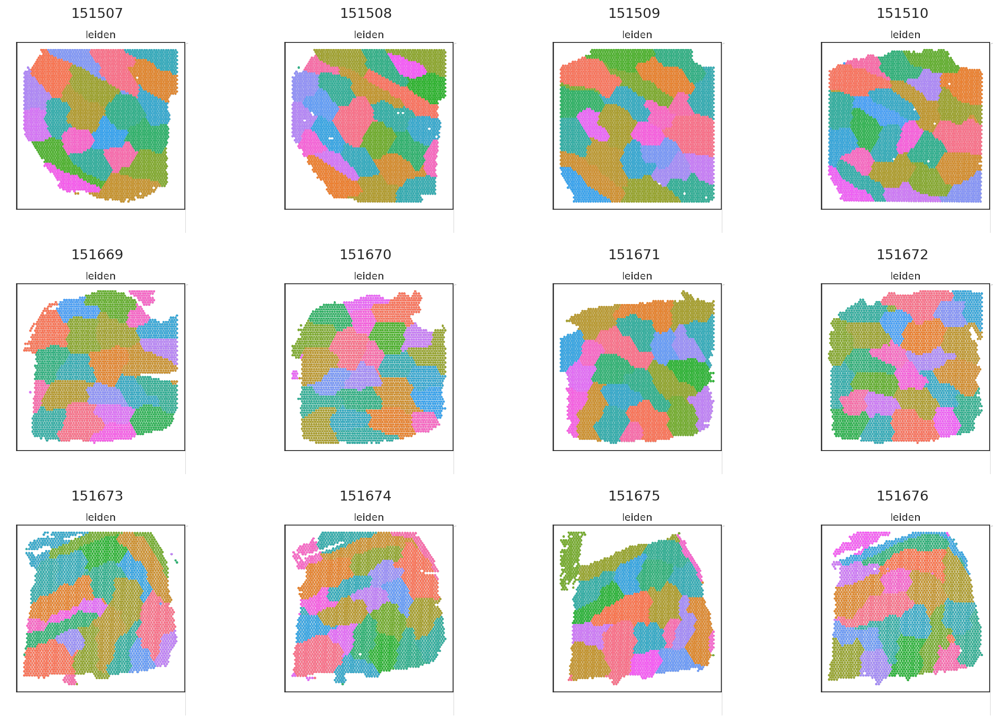

In [156]:
fig, axes = combine_images(
    spatialpca_output_df, img_path_col='spatial_fig_png',
    x_min=50,
    x_max=550,
    y_min=20,# top
    y_max=700, # bottom
)
plt.show()

# SIMBA RNAseq only

In [43]:
simba_rna_only_output_fn = "../results/00/simba_rna_only/run_simba_rna_only.output.tsv"
simba_rna_only_output_df = pd.read_csv(simba_rna_only_output_fn, sep='\t', index_col=0)

In [50]:
simba_RNA_performance_fn = "../results/00/simba_rna_only/run_simba_rna_only.output.performance.tsv"
simba_RNA_performance_fn

'../results/00/simba_rna_only/run_simba_rna_only.output.performance.tsv'

In [52]:
run_leiden_clustering(
    adata_output_df=simba_rna_only_output_df,
    path_col="run_simba_rna_only",
    cell_embedding_adata_fn="adata_C.h5ad",
    performance_output_fn=simba_RNA_performance_fn,
)

100%|██████████| 12/12 [01:17<00:00,  6.43s/it]


In [172]:
simba_RNA_performance_df = pd.read_csv(simba_RNA_performance_fn, sep='\t', index_col=0)
simba_RNA_performance_df.head()

,silhoutte,ARI,NMI,pca_adata_fn,leiden_adata_fn
151675,-0.042192,0.323036,0.387988,NaN,../results/00/simba_rna_only/151675/PCA.adata_...
151507,-0.047134,0.265486,0.346989,NaN,../results/00/simba_rna_only/151507/PCA.adata_...
151510,-0.037298,0.172971,0.265068,NaN,../results/00/simba_rna_only/151510/PCA.adata_...
151674,-0.027114,0.299444,0.382337,NaN,../results/00/simba_rna_only/151674/PCA.adata_...
151669,0.021184,0.180573,0.317557,NaN,../results/00/simba_rna_only/151669/PCA.adata_...


In [66]:
simba_RNA_performance_df = generate_umap_figures(
    simba_rna_only_output_df, # getting directory
    path_col='run_simba_rna_only',
    fig_path='../results/00/simba_rna_only/UMAP_LEIDEN',
    cell_embedding_adata_fn='PCA.adata_C.h5ad', # TODO: fix prefix
    adata_color_col='leiden',
    fig_exts=['png', 'svg'],
    run_umap=True,
    palette=None,
)

Saving results in: ../results/00/simba_rna_only/UMAP_LEIDEN


  0%|          | 0/12 [00:00<?, ?it/s]

100%|██████████| 12/12 [02:10<00:00, 10.89s/it]


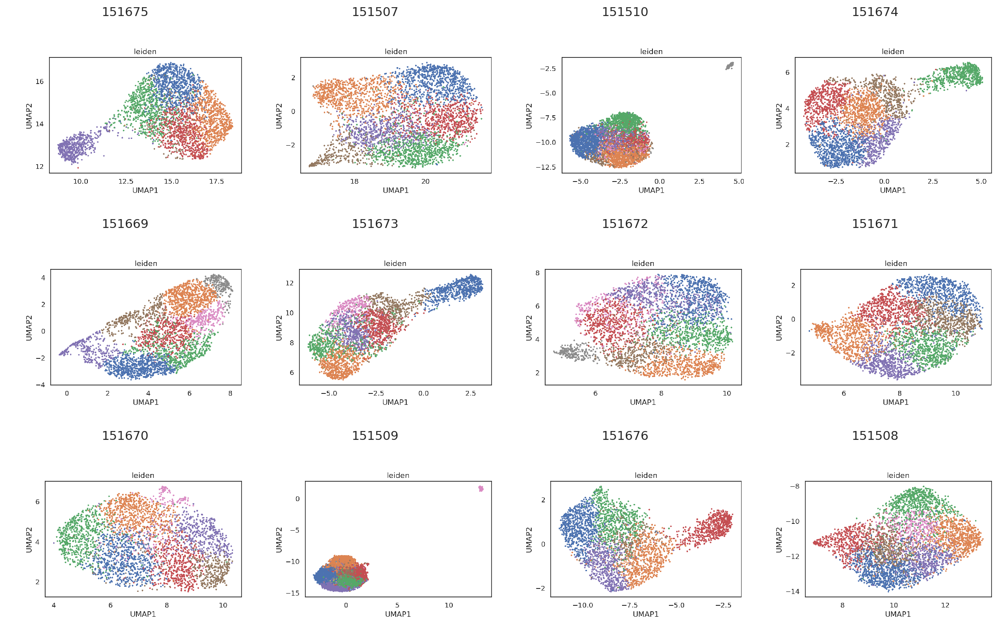

In [71]:
fig, axes = combine_images(
    simba_RNA_performance_df, img_path_col='umap_fig_png',
    x_min=80,
    x_max=950,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

In [118]:
from benchmarking.plot import generate_spatial_figures

 58%|█████▊    | 7/12 [00:02<00:01,  3.00it/s]

100%|██████████| 12/12 [00:03<00:00,  3.07it/s]


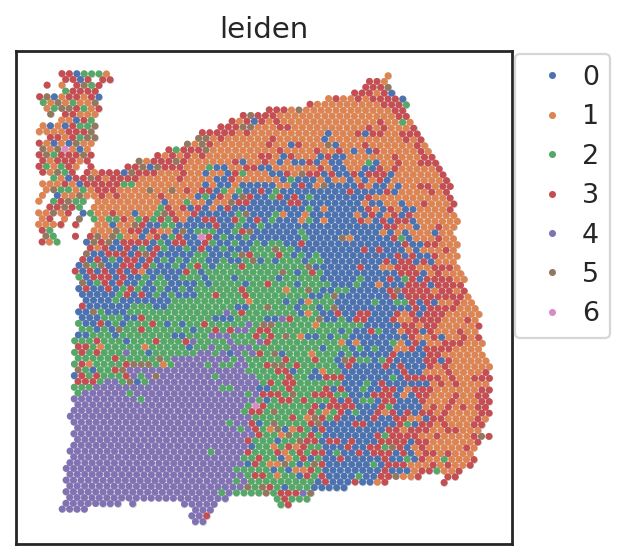

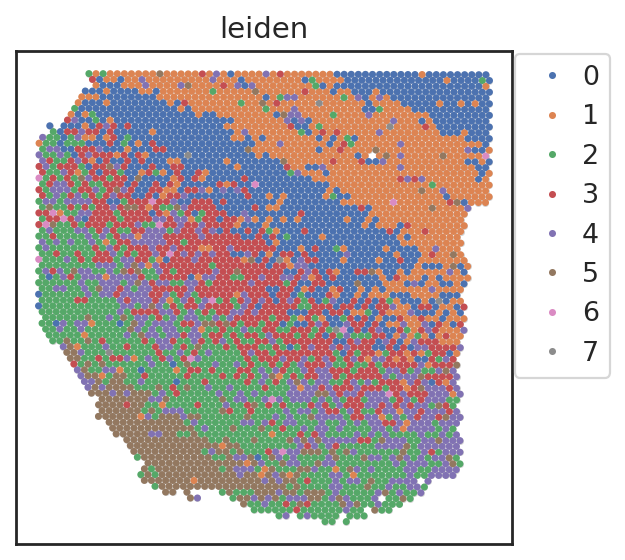

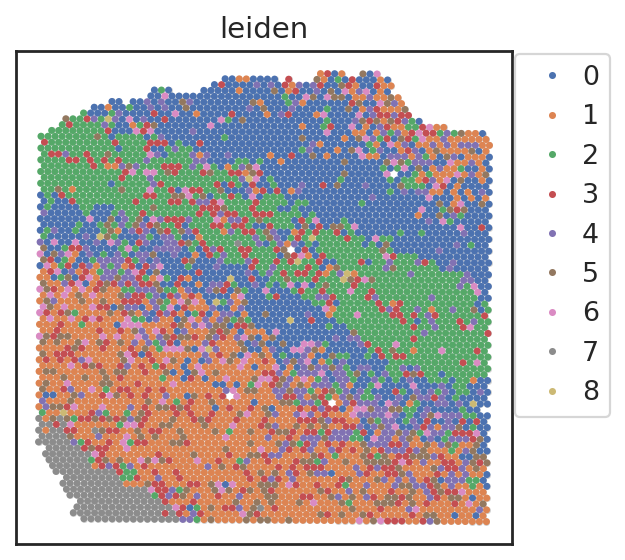

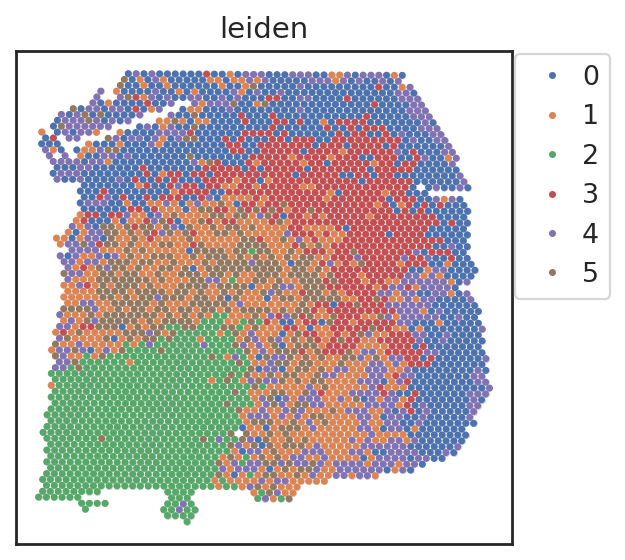

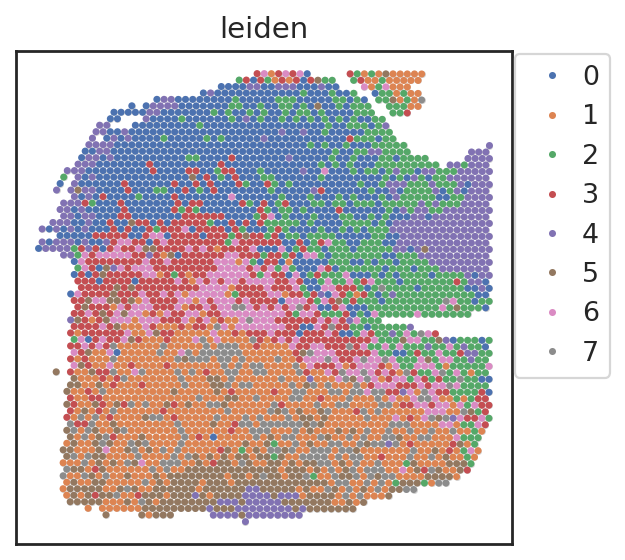

...

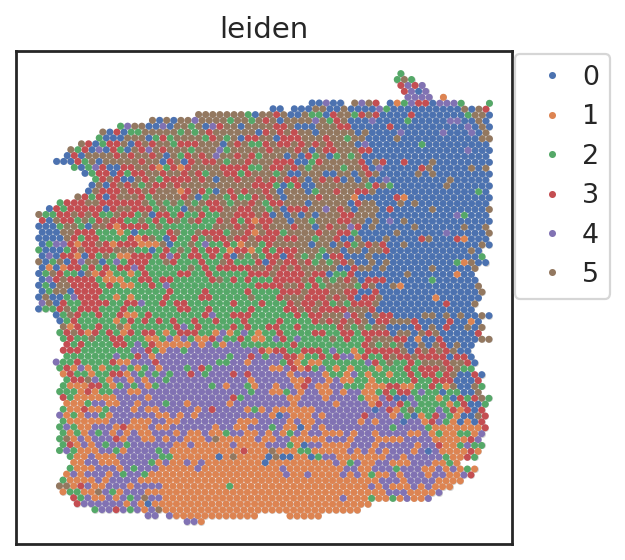

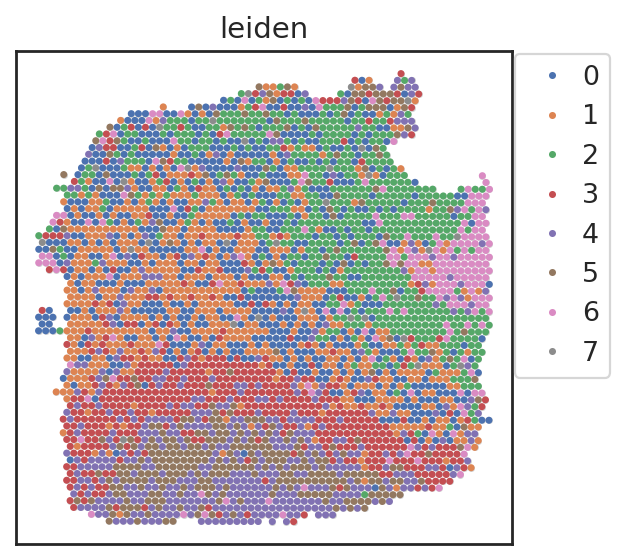

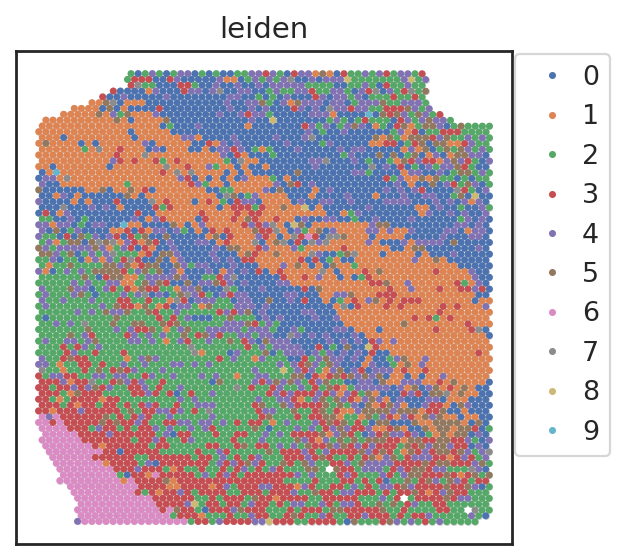

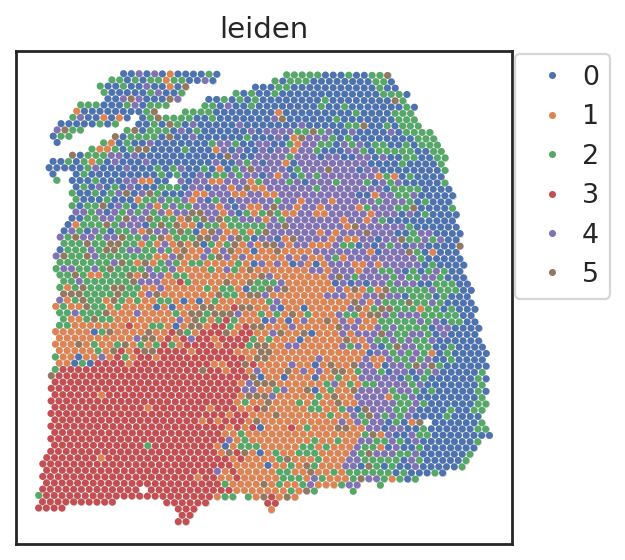

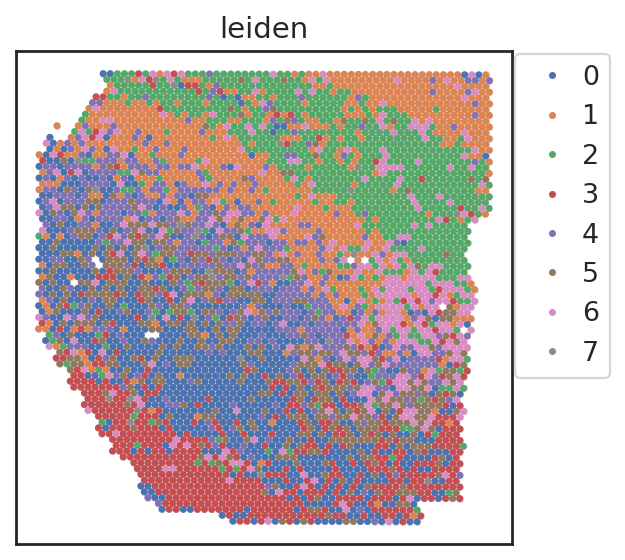

In [146]:
simba_rna_only_output_df = generate_spatial_figures(
    simba_rna_only_output_df,
    path_col="run_simba_rna_only",
    cell_embedding_adata_fn="PCA.adata_C.h5ad",
    adata_spatial_dir="/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/data/human_DLPFC/", # directory with the spatial coordinates.e.g.  <sample_id>.h5ad
    fig_path = "../results/00/simba_rna_only/UMAP_LEIDEN_SPATIAL",
    adata_color_col="leiden", # leiden, etc.
    fig_exts=["png"],
    s=10, 
    fig_ncol=1,
    linewidth=0
)

In [147]:
simba_rna_only_output_df

,run_simba_rna_only,umap_fig_png,umap_fig_svg,spatial_fig_png
151675,../results/00/simba_rna_only/151675,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151507,../results/00/simba_rna_only/151507,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151510,../results/00/simba_rna_only/151510,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151674,../results/00/simba_rna_only/151674,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151669,../results/00/simba_rna_only/151669,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151673,../results/00/simba_rna_only/151673,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151672,../results/00/simba_rna_only/151672,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151671,../results/00/simba_rna_only/151671,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151670,../results/00/simba_rna_only/151670,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...
151509,../results/00/simba_rna_only/151509,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...,../results/00/simba_rna_only/UMAP_LEIDEN/figur...,../results/00/simba_rna_only/UMAP_LEIDEN_SPATI...


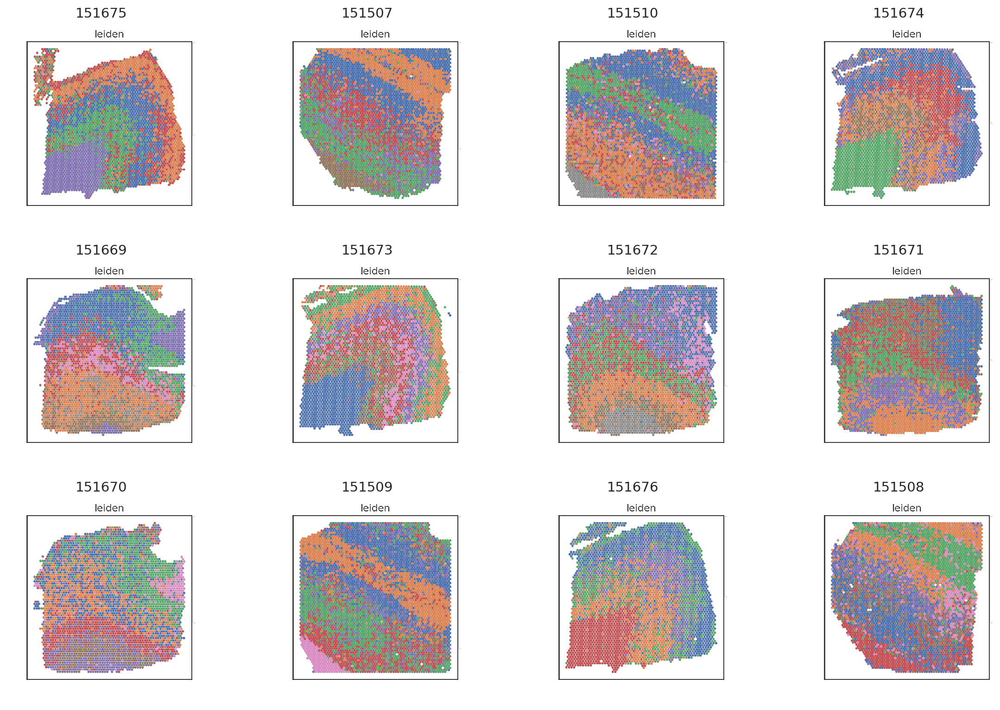

In [148]:
fig, axes = combine_images(
    simba_rna_only_output_df, img_path_col='spatial_fig_png',
    x_min=20,
    x_max=550,
    y_min=20,# top
    y_max=800, # bottom
)
plt.show()

# Aggregate performance metrics

In [175]:
pca_performance_df['method'] = 'PCA'
simba_RNA_performance_df['method'] = 'SIMBA_RNA'
spatialPCA_performance_df['method'] = 'SpatialPCA'

In [176]:
performance_df = pd.concat([pca_performance_df, simba_RNA_performance_df, spatialPCA_performance_df])

In [179]:
performance_df.columns

Index(['silhoutte', 'ARI', 'NMI', 'pca_adata_fn', 'method', 'leiden_adata_fn'], dtype='object')

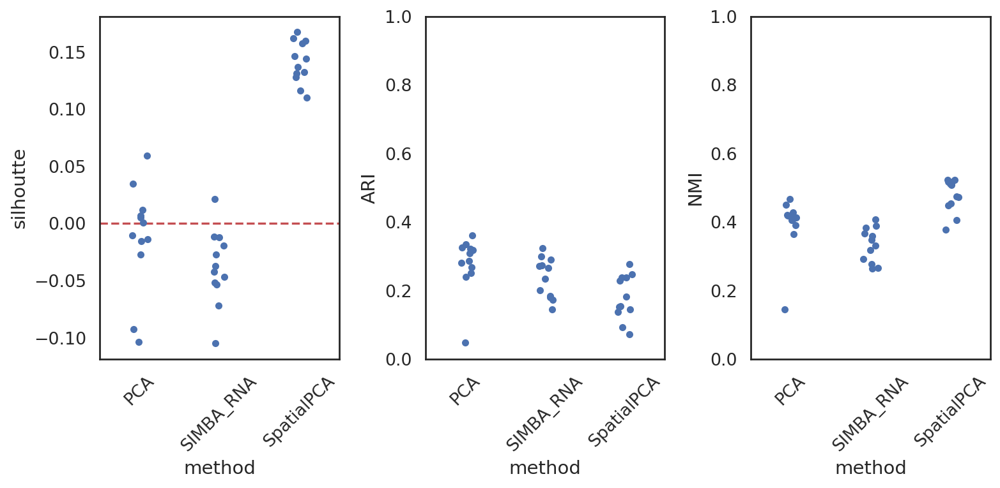

In [191]:
fig, axes = plt.subplots(1, 3, figsize=(10, 5), sharex=True)

for i, measure in enumerate(['silhoutte', 'ARI', 'NMI']):
    sns.stripplot(performance_df.reset_index(), x='method', y=measure, ax=axes[i])

    if measure in ['ARI', 'NMI']:
        axes[i].set_ylim(0, 1)
    if measure == 'silhoutte':
        axes[i].axhline(0, c='r', linestyle='--')

    for tick in axes[i].get_xticklabels():
        tick.set_rotation(45)

plt.tight_layout()
plt.show()
